### Index

[1. Presentation of the challenge](#1) <br>
- [1.1 - The RavenPack Data Science Challenge](#1.1) <br>
- [1.2 - Overview of the approach](#1.2)<br><br>

[2. Collect & transform data](#2) <br>
- [2.1 - Connection à SQL Server](#2.1) <br>
- [2.2 - Mise au format des données](#2.2)<br>
- [](#2.3)<br>
- [](#2.4)<br>
- [](#2.5)<br>

[3. Descriptive analysis / Statistical inferences](#3) <br>
- [](#3.1)<br>
- [](#3.2)<br>
- [](#3.3)<br>
- [](#3.4)<br>

[4. Preprocess the data](#4) <br>
- [4.1 - Clustering](#4.1)<br>
- [4.2 - Création de la target (y)](#4.2)<br>
- [4.3 - Valeurs aberrantes](#4.3)<br>
- [4.4 - One-hot-encoding](#4.4)<br><br>

[5. Create features](#5) <br>
- [5.1 - Dataset du modèle 1](#5.1)<br>
- [](#5.2)<br>
- [](#5.3)<br>
- [](#5.4)<br>

[6. Select a ML algo](#6) <br>
- [6.1 - Dataset du modèle 1](#6.1)<br>
- [](#6.2)<br>
- [](#6.3)<br>
- [](#6.4)<br>

[7. Backtest on unseen data](#7) <br>
- [7.1 - Dataset du modèle 1](#7.1)<br>
- [](#7.2)<br>
- [](#7.3)<br>
- [](#7.4)<br>

___
# <a id =1> </a>  **1. Presentation of the challenge**
___

### 1.1 <a id =1.1> </a>The RavenPack Data Science Challenge

<br>

Dataset (in csv format) with the following structure (column wise):

<br>

| label : | 'description' |
| ----------- | ----------- |
| DATE | A given date |
|  RP_ENTITY_ID | An asset ID |
|  T0_RETURN | Return on the given date |
|  T1_RETURN |  Next day Return |
|  A set of 36 different Indicators |  (Features) |

<br>

<p style="border: 0px ridge white;
          color: color_police;
          background-color: colr;
          padding: 5rem;
          display: flex;
          flex-direction: column;
          font: small-caps bold 2rem sans-serif;
          text-align: justify;">
The aim of this project is to come up with a model/algorithm to produce predictions on T1_RETURN using the available information.
    <br><br>
You are expected to use said predictions to form a portfolio that will then be evaluated according to Information Ratio.
</p>

<br>

**As an output, you are asked to provide:**

- A short report on what you have done together with some results and conclusions, including a performance comparison among the models you propose, using Information Ratio as a metric.

- The source code used for producing your analysis and results.

<br><br>
The project will allow us to evaluate your skill set within programming, data preparation, modeling, and communication. 

<br><br>
links to the files :

https://drive.google.com/a/rav...

https://drive.google.com/a/rav...

<pre><code>
#################################
#######  SAMPLE CODE   ##########
#################################
library(data.table)
# Open CSV file and convert to data table*
# Full path to your csv file
fullPath = \<The path to the provided csv file goes here>
DataSet = data.table(read.csv(file = fullPath))
# We have a panel data.table with information about dates, Entity IDs, Returns (T1 and T0), and 36 different indicators).


### Example on how to check the performance of a given prediction.
# Lets say we are using the sign of an indicator(GROUP_E_ALL_SG90) as predictor
# We select only the data we are interested in
PredictionData = subset(DataSet, select = c('DATE', 'RP_ENTITY_ID','GROUP_E_ALL_SG90', 'T1_RETURN'))
# We drop NA's
PredictionData = PredictionData[complete.cases(PredictionData)]
# We get unique rows
PredictionData = unique(PredictionData)
# We sort by DATE, setting its key
setkey(PredictionData,'DATE')
# Compute Average Return per day using the sign of the indicator as predictor*
PredictionData[, AVGRET:= mean(sign(GROUP_E_ALL_SG90)*T1_RETURN,na.rm = TRUE), by = c('DATE')]
Results = subset(PredictionData,select = c('DATE','AVGRET'))
Results = unique(Results)
# We plot the Cummulative Log Returns
plot( as.Date(Results$DATE), cumsum(log(Results$AVGRET+1)), t = 'l', col = 'blue', ylab = 'Cummulative Return', xlab = 'DATE')


### Some Stats
# AnnualizedReturn
AnnualizedReturn = mean(log(Results$AVGRET+1))*252
# AnnualizedVolatility
AnnualizedVolatility = sqrt(var(log(Results$AVGRET+1)))*sqrt(252)
# Information Ratio 
InformationRatio = AnnualizedReturn/AnnualizedVolatility
title(paste('Return Profile - Information Ratio', round(InformationRatio,2)))

</code>
</pre>

### <a id =1.2> </a> 1.2 Overview of the approach

___
# <a id =2> </a> **2. Collect & transform data**
___

In [1]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from IPython.core.display import display, HTML
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

In [2]:
display(HTML("<style> *{margin:0; padding:0;} html, body, \
             .container{margin:2;!important padding:0;!important} \
             .container { width:100% !important;}</style>"))


In [3]:
df = pd.read_csv('./SampleDataSet.csv')

In [70]:
df.head(60)
df.tail(60)

,DATE,RP_ENTITY_ID,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,...,GROUP_AM_HEAD,GROUP_AM_BODY,GROUP_AM_ALL_SG90,GROUP_AM_HEAD_SG90,GROUP_AM_BODY_SG90,GROUP_AM_ALL_SG365,GROUP_AM_HEAD_SG365,GROUP_AM_BODY_SG365,T0_RETURN,T1_RETURN
1764764,2017-02-17,E49AA3,0.263333,NaN,0.305000,NaN,NaN,NaN,NaN,NaN,...,NaN,0.305000,NaN,NaN,NaN,NaN,NaN,NaN,0.006505,NaN
1764765,2017-02-17,E49AA3,0.263333,NaN,0.305000,0.610000,NaN,0.610,0.610000,NaN,...,NaN,0.305000,NaN,NaN,NaN,NaN,NaN,NaN,0.006505,NaN
1764766,2017-02-17,E49AA3,0.263333,0.180000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.006505,NaN
1764767,2017-02-17,E4CE73,0.157500,0.326522,NaN,0.335652,0.493077,NaN,0.390000,0.475833,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.009608,NaN
1764768,2017-02-17,E4CE73,0.157500,NaN,0.039697,0.335652,NaN,0.131,0.390000,NaN,...,NaN,0.039697,NaN,NaN,NaN,NaN,NaN,NaN,-0.009608,NaN
1764769,2017-02-17,E4CE73,0.157500,NaN,0.039697,0.335652,NaN,0.131,NaN,NaN,...,NaN,0.039697,NaN,NaN,NaN,NaN,NaN,NaN,-0.009608,NaN
1764770,2017-02-17,E4CE73,0.157500,NaN,0.039697,NaN,NaN,NaN,NaN,NaN,...,NaN,0.039697,NaN,NaN,NaN,NaN,NaN,NaN,-0.009608,NaN
1764771,2017-02-17,E4CE73,0.157500,0.326522,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.009608,NaN
1764772,2017-02-17,E4CE73,0.157500,0.326522,NaN,0.335652,0.493077,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.009608,NaN
1764773,2017-02-17,E5D727,0.010000,0.010000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.047700,NaN


In [262]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1764824 entries, 0 to 1764823
Data columns (total 40 columns):
 #   Column               Dtype  
---  ------               -----  
 0   DATE                 object 
 1   RP_ENTITY_ID         object 
 2   GLOBAL_ALL           float64
 3   GLOBAL_HEAD          float64
 4   GLOBAL_BODY          float64
 5   GLOBAL_ALL_SG90      float64
 6   GLOBAL_HEAD_SG90     float64
 7   GLOBAL_BODY_SG90     float64
 8   GLOBAL_ALL_SG365     float64
 9   GLOBAL_HEAD_SG365    float64
 10  GLOBAL_BODY_SG365    float64
 11  GROUP_A_ALL          float64
 12  GROUP_A_HEAD         float64
 13  GROUP_A_BODY         float64
 14  GROUP_A_ALL_SG90     float64
 15  GROUP_A_HEAD_SG90    float64
 16  GROUP_A_BODY_SG90    float64
 17  GROUP_A_ALL_SG365    float64
 18  GROUP_A_HEAD_SG365   float64
 19  GROUP_A_BODY_SG365   float64
 20  GROUP_E_ALL          float64
 21  GROUP_E_HEAD         float64
 22  GROUP_E_BODY         float64
 23  GROUP_E_ALL_SG90     float64
 24

In [4]:
df['DATE'] = pd.to_datetime(df['DATE'])

In [5]:
descr = df.describe()
pd.options.display.max_columns = None
display(descr)

,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,GLOBAL_BODY_SG365,GROUP_A_ALL,GROUP_A_HEAD,GROUP_A_BODY,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GROUP_A_BODY_SG90,GROUP_A_ALL_SG365,GROUP_A_HEAD_SG365,GROUP_A_BODY_SG365,GROUP_E_ALL,GROUP_E_HEAD,GROUP_E_BODY,GROUP_E_ALL_SG90,GROUP_E_HEAD_SG90,GROUP_E_BODY_SG90,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GROUP_E_BODY_SG365,GROUP_AM_ALL,GROUP_AM_HEAD,GROUP_AM_BODY,GROUP_AM_ALL_SG90,GROUP_AM_HEAD_SG90,GROUP_AM_BODY_SG90,GROUP_AM_ALL_SG365,GROUP_AM_HEAD_SG365,GROUP_AM_BODY_SG365,T0_RETURN,T1_RETURN
count,1.764824e+06,661969.000000,1.102855e+06,878391.000000,374304.000000,504087.000000,690269.000000,306698.000000,383571.000000,464688.000000,274104.000000,1.102855e+06,261374.000000,174391.000000,86983.000000,228894.000000,151697.000000,77197.000000,803938.000000,264392.000000,1.102855e+06,405933.000000,146451.000000,259482.000000,298572.000000,111088.000000,187484.000000,0.0,0.0,1.102855e+06,0.0,0.0,0.0,0.0,0.0,0.0,1.762002e+06,1.758998e+06
mean,2.228388e-01,0.189778,2.407624e-01,0.202441,0.172764,0.226045,0.198085,0.168985,0.223448,0.105639,0.137964,2.407624e-01,0.110891,0.140222,0.049359,0.115602,0.147119,0.050983,0.108108,0.105423,2.407624e-01,0.114938,0.109754,0.115567,0.103354,0.091684,0.108981,NaN,NaN,2.407624e-01,NaN,NaN,NaN,NaN,NaN,NaN,3.264422e-04,-1.408236e-04
std,3.741778e-01,0.449429,3.561076e-01,0.393646,0.466463,0.365822,0.414940,0.483412,0.389471,0.567168,0.584229,3.561076e-01,0.563097,0.583875,0.541278,0.576636,0.597656,0.552625,0.321404,0.356829,3.561076e-01,0.333996,0.367305,0.340001,0.348356,0.374241,0.361705,NaN,NaN,3.561076e-01,NaN,NaN,NaN,NaN,NaN,NaN,3.782160e-02,2.432372e-02
min,-1.000000e+00,-1.000000,-1.000000e+00,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.990000,-0.990000,-1.000000e+00,-0.990000,-0.990000,-0.990000,-0.990000,-0.990000,-0.990000,-1.000000,-1.000000,-1.000000e+00,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,NaN,NaN,-1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,-9.107880e-01,-9.060107e-01
25%,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.380000,-0.217500,0.000000e+00,-0.340000,-0.180000,-0.580000,-0.386667,-0.193333,-0.580000,0.000000,0.000000,0.000000e+00,0.000000,-0.005714,0.000000,0.000000,-0.005339,0.000000,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,-9.993569e-03,-8.597890e-03
50%,2.440000e-01,0.176503,2.744444e-01,0.216667,0.108229,0.250000,0.204687,0.063333,0.272000,0.000000,0.000000,2.744444e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.055556,0.000000,2.744444e-01,0.057647,0.000000,0.045000,0.000000,0.000000,0.000000,NaN,NaN,2.744444e-01,NaN,NaN,NaN,NaN,NaN,NaN,-5.214972e-05,-2.785987e-04
75%,5.438462e-01,0.568173,5.522222e-01,0.540000,0.566087,0.560000,0.550000,0.570000,0.571667,0.620000,0.754000,5.522222e-01,0.620000,0.746667,0.540000,0.620000,0.830000,0.540000,0.324569,0.400000,5.522222e-01,0.350000,0.420000,0.311818,0.352128,0.401000,0.343177,NaN,NaN,5.522222e-01,NaN,NaN,NaN,NaN,NaN,NaN,1.029148e-02,7.970889e-03
max,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.950000,0.950000,1.000000e+00,0.950000,0.950000,0.950000,0.950000,0.950000,0.950000,1.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN,1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,2.955917e+00,1.344644e+00


In [6]:
df = df.groupby(['RP_ENTITY_ID', 'DATE'], as_index=False).first()


In [7]:
descr = df.describe()
pd.options.display.max_columns = None
display(descr)

,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,GLOBAL_BODY_SG365,GROUP_A_ALL,GROUP_A_HEAD,GROUP_A_BODY,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GROUP_A_BODY_SG90,GROUP_A_ALL_SG365,GROUP_A_HEAD_SG365,GROUP_A_BODY_SG365,GROUP_E_ALL,GROUP_E_HEAD,GROUP_E_BODY,GROUP_E_ALL_SG90,GROUP_E_HEAD_SG90,GROUP_E_BODY_SG90,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GROUP_E_BODY_SG365,GROUP_AM_ALL,GROUP_AM_HEAD,GROUP_AM_BODY,GROUP_AM_ALL_SG90,GROUP_AM_HEAD_SG90,GROUP_AM_BODY_SG90,GROUP_AM_ALL_SG365,GROUP_AM_HEAD_SG365,GROUP_AM_BODY_SG365,T0_RETURN,T1_RETURN
count,712758.000000,374223.000000,593694.000000,502255.000000,297136.000000,364745.000000,461161.000000,279582.000000,326665.000000,238966.000000,180207.000000,593694.000000,194794.000000,161195.000000,82603.000000,183079.000000,151697.000000,77197.000000,395107.000000,154063.000000,593694.000000,248890.000000,116621.000000,208437.000000,228875.000000,111088.000000,187484.000000,0.0,0.0,593694.000000,0.0,0.0,0.0,0.0,0.0,0.0,711495.000000,710458.000000
mean,0.244088,0.199741,0.256547,0.224301,0.177853,0.238520,0.213349,0.172612,0.226613,0.107987,0.147164,0.256547,0.125266,0.146775,0.051535,0.125268,0.147119,0.050983,0.100056,0.091685,0.256547,0.102860,0.094373,0.113465,0.097377,0.091684,0.108981,NaN,NaN,0.256547,NaN,NaN,NaN,NaN,NaN,NaN,0.000297,-0.000072
std,0.411034,0.473261,0.394679,0.432378,0.490593,0.396663,0.439598,0.494785,0.404791,0.577627,0.588504,0.394679,0.575949,0.591763,0.548132,0.582277,0.597656,0.552625,0.361950,0.380860,0.394679,0.362855,0.374789,0.360626,0.360552,0.374241,0.361705,NaN,NaN,0.394679,NaN,NaN,NaN,NaN,NaN,NaN,0.028201,0.022911
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.990000,-0.990000,-1.000000,-0.990000,-0.990000,-0.990000,-0.990000,-0.990000,-0.990000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,NaN,NaN,-1.000000,NaN,NaN,NaN,NaN,NaN,NaN,-0.910788,-0.906011
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.499342,-0.197500,0.000000,-0.340000,-0.180000,-0.580000,-0.380000,-0.193333,-0.580000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.005339,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,-0.008589,-0.008115
50%,0.305000,0.180000,0.310000,0.248333,0.082000,0.305000,0.220000,0.047500,0.290000,0.010000,0.010000,0.310000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.310000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,0.310000,NaN,NaN,NaN,NaN,NaN,NaN,-0.000071,-0.000187
75%,0.587640,0.585390,0.600000,0.585000,0.580000,0.590000,0.585000,0.580000,0.587500,0.620000,0.788545,0.600000,0.620000,0.806667,0.540000,0.626667,0.830000,0.540000,0.346050,0.403592,0.600000,0.350000,0.404000,0.336667,0.350000,0.401000,0.343177,NaN,NaN,0.600000,NaN,NaN,NaN,NaN,NaN,NaN,0.008641,0.007616
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.950000,0.950000,1.000000,0.950000,0.950000,0.950000,0.950000,0.950000,0.950000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,2.955917,1.344644


In [8]:
###col with 100% NA
cols_to_drop = descr.columns[descr.loc['count',:]==0]
###delete these cols
df = df.loc[:, ~df.columns.isin(cols_to_drop)]

In [12]:
df.DATE.value_counts()

2013-10-28    668
2016-07-29    625
2017-02-02    613
2017-02-08    609
2016-07-28    604
             ... 
2005-12-30     38
2008-12-26     37
2009-05-25     34
2005-11-25     32
2006-07-04     18
Name: DATE, Length: 3099, dtype: int64

In [109]:
df.RP_ENTITY_ID.value_counts()

619882    3093
50070E    3092
9196A2    3083
990AD0    3027
CFF97C    3003
          ... 
9F2C11       1
CB6A9C       1
B09F19       1
DDC25F       1
AA1F21       1
Name: RP_ENTITY_ID, Length: 1768, dtype: int64

In [159]:
(df.RP_ENTITY_ID.value_counts()>=0).sum()

1768

In [160]:
(df.RP_ENTITY_ID.value_counts()>750).sum()

259

In [ ]:
###number of rows when selecting assets with a track record > 3 years
nb_assets = (df.RP_ENTITY_ID.value_counts()>=0).sum()
nb_assets_3y = (df.RP_ENTITY_ID.value_counts()>756).sum()
df.RP_ENTITY_ID.value_counts()[:-(nb_assets-nb_assets_3y)].sum()

In [162]:
df.RP_ENTITY_ID.value_counts()[-1500:-800]

EB6965    734
39FB23    734
977A1E    732
7B1E50    730
8C6C1B    726
         ... 
0FABBD    234
EB76B5    234
009397    234
34A009    234
5D43A7    233
Name: RP_ENTITY_ID, Length: 700, dtype: int64

In [108]:
df.RP_ENTITY_ID.value_counts().describe()

count    1768.000000
mean      403.143665
std       461.307941
min         1.000000
25%        88.000000
50%       267.500000
75%       547.250000
max      3093.000000
Name: RP_ENTITY_ID, dtype: float64

In [134]:
df.iloc[:,2:-6]

,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,GLOBAL_BODY_SG365,GROUP_A_ALL,GROUP_A_HEAD,GROUP_A_BODY,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GROUP_A_BODY_SG90,GROUP_A_ALL_SG365,GROUP_A_HEAD_SG365,GROUP_A_BODY_SG365,GROUP_E_ALL,GROUP_E_HEAD,GROUP_E_BODY,GROUP_E_ALL_SG90,GROUP_E_HEAD_SG90,GROUP_E_BODY_SG90,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GROUP_E_BODY_SG365,GROUP_AM_BODY
0,0.610000,NaN,0.610000,0.61,NaN,0.61,0.61,NaN,0.61,NaN,NaN,0.610000,NaN,NaN,NaN,NaN,NaN,NaN,0.61,NaN,0.610000,0.61,NaN,0.61,0.61,NaN,0.61,0.610000
1,0.010000,0.010000,NaN,0.01,0.01,NaN,0.01,0.01,NaN,0.01,0.01,NaN,0.01,0.01,NaN,0.01,0.01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.633333,0.633333,NaN,0.66,0.66,NaN,0.70,0.70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.70,0.7,NaN,0.70,0.7,NaN,0.70,0.7,NaN,NaN
3,0.550000,NaN,0.550000,0.55,NaN,0.55,0.55,NaN,0.55,NaN,NaN,0.550000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.550000,NaN,NaN,NaN,NaN,NaN,NaN,0.550000
4,0.000000,NaN,0.000000,0.00,NaN,0.00,0.00,NaN,0.00,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,0.00,NaN,0.000000,0.00,NaN,0.00,0.00,NaN,0.00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
712753,0.220000,NaN,0.220000,0.22,NaN,0.22,0.22,NaN,0.22,NaN,NaN,0.220000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.220000,NaN,NaN,NaN,NaN,NaN,NaN,0.220000
712754,0.635000,NaN,0.635000,0.70,NaN,0.70,0.70,NaN,0.70,NaN,NaN,0.635000,NaN,NaN,NaN,NaN,NaN,NaN,0.70,NaN,0.635000,0.70,NaN,0.70,0.70,NaN,0.70,0.635000
712755,0.220000,0.220000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
712756,-0.386667,NaN,-0.386667,0.00,NaN,0.00,0.00,NaN,0.00,-0.58,NaN,-0.386667,NaN,NaN,NaN,NaN,NaN,NaN,0.00,NaN,-0.386667,0.00,NaN,0.00,0.00,NaN,0.00,-0.386667


In [196]:
df['DAY']=df['DATE'].dt.day
df['MONTH']=df['DATE'].dt.month
df['YEAR']=df['DATE'].dt.year
df['SUM'] = df.iloc[:,2:-6].sum(axis=1)
df[['DATE', 'DAY', 'MONTH', 'YEAR', 'RP_ENTITY_ID','GLOBAL_HEAD', 'SUM', 'T0_RETURN', 'T1_RETURN']].head(60)
# df.loc[:,['DATE','RP_ENTITY_ID','GLOBAL_HEAD', 'T0_RETURN', 'T1_RETURN']].sort_values(by=['RP_ENTITY_ID','DATE'], ascending=True)

,DATE,DAY,MONTH,YEAR,RP_ENTITY_ID,GLOBAL_HEAD,SUM,T0_RETURN,T1_RETURN
0,2005-01-03,3,1,2005,0157B1,NaN,7.930000,0.018520,-0.037526
1,2005-01-03,3,1,2005,046263,0.010000,0.120000,-0.001415,0.007740
2,2005-01-03,3,1,2005,07CA6A,0.633333,8.186667,-0.005460,0.008110
3,2005-01-03,3,1,2005,0BC29E,NaN,4.400000,0.018809,0.019265
4,2005-01-03,3,1,2005,0BC6D8,NaN,0.000000,-0.002185,0.008238
5,2005-01-03,3,1,2005,0BE0AE,0.620000,2.480000,0.000009,0.002435
6,2005-01-03,3,1,2005,0D920D,NaN,0.000000,-0.002242,0.006588
7,2005-01-03,3,1,2005,1921DD,0.532000,2.064000,0.015793,0.003908
8,2005-01-03,3,1,2005,1A3E1B,0.000000,0.000000,0.005717,0.017611
9,2005-01-03,3,1,2005,1FCC00,-0.740000,-5.920000,-0.017175,-0.020631


In [143]:
df.iloc[:,:].isna().sum(axis=0)

DATE                       0
RP_ENTITY_ID               0
GLOBAL_ALL                 0
GLOBAL_HEAD           338535
GLOBAL_BODY           119064
GLOBAL_ALL_SG90       210503
GLOBAL_HEAD_SG90      415622
GLOBAL_BODY_SG90      348013
GLOBAL_ALL_SG365      251597
GLOBAL_HEAD_SG365     433176
GLOBAL_BODY_SG365     386093
GROUP_A_ALL           473792
GROUP_A_HEAD          532551
GROUP_A_BODY          119064
GROUP_A_ALL_SG90      517964
GROUP_A_HEAD_SG90     551563
GROUP_A_BODY_SG90     630155
GROUP_A_ALL_SG365     529679
GROUP_A_HEAD_SG365    561061
GROUP_A_BODY_SG365    635561
GROUP_E_ALL           317651
GROUP_E_HEAD          558695
GROUP_E_BODY          119064
GROUP_E_ALL_SG90      463868
GROUP_E_HEAD_SG90     596137
GROUP_E_BODY_SG90     504321
GROUP_E_ALL_SG365     483883
GROUP_E_HEAD_SG365    601670
GROUP_E_BODY_SG365    525274
GROUP_AM_BODY         119064
T0_RETURN               1263
T1_RETURN               2300
DAY                        0
MONTH                      0
YEAR          

In [264]:
df.iloc[:,:].isna().sum(axis=0)/len(df)

DATE                   0.000000
RP_ENTITY_ID           0.000000
GLOBAL_ALL             0.000000
GLOBAL_HEAD            0.624909
GLOBAL_BODY            0.375091
GLOBAL_ALL_SG90        0.502278
GLOBAL_HEAD_SG90       0.787909
GLOBAL_BODY_SG90       0.714370
GLOBAL_ALL_SG365       0.608874
GLOBAL_HEAD_SG365      0.826216
GLOBAL_BODY_SG365      0.782658
GROUP_A_ALL            0.736694
GROUP_A_HEAD           0.844685
GROUP_A_BODY           0.375091
GROUP_A_ALL_SG90       0.851898
GROUP_A_HEAD_SG90      0.901185
GROUP_A_BODY_SG90      0.950713
GROUP_A_ALL_SG365      0.870302
GROUP_A_HEAD_SG365     0.914044
GROUP_A_BODY_SG365     0.956258
GROUP_E_ALL            0.544466
GROUP_E_HEAD           0.850188
GROUP_E_BODY           0.375091
GROUP_E_ALL_SG90       0.769987
GROUP_E_HEAD_SG90      0.917017
GROUP_E_BODY_SG90      0.852970
GROUP_E_ALL_SG365      0.830821
GROUP_E_HEAD_SG365     0.937054
GROUP_E_BODY_SG365     0.893766
GROUP_AM_ALL           1.000000
GROUP_AM_HEAD          1.000000
GROUP_AM

___
# <a id =3> </a> **3. Descriptive analysis / Statistical inferences**
___

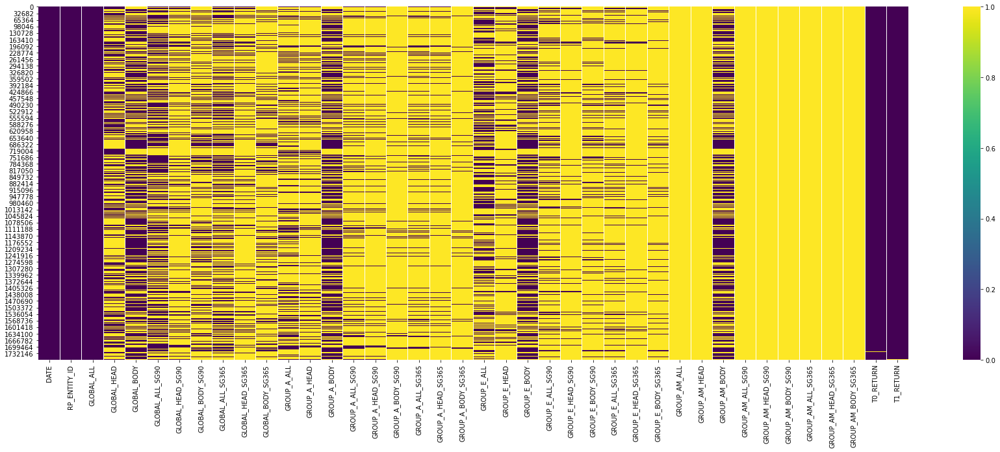

In [263]:
plt.figure(figsize=(30,10))
sns.heatmap(df.iloc[:,:].isna(),cmap='viridis');
## Missing value: no evident temporal structure
###Imputations with RF are good for strong non-linear relationships between continuous variables and when there are interactions

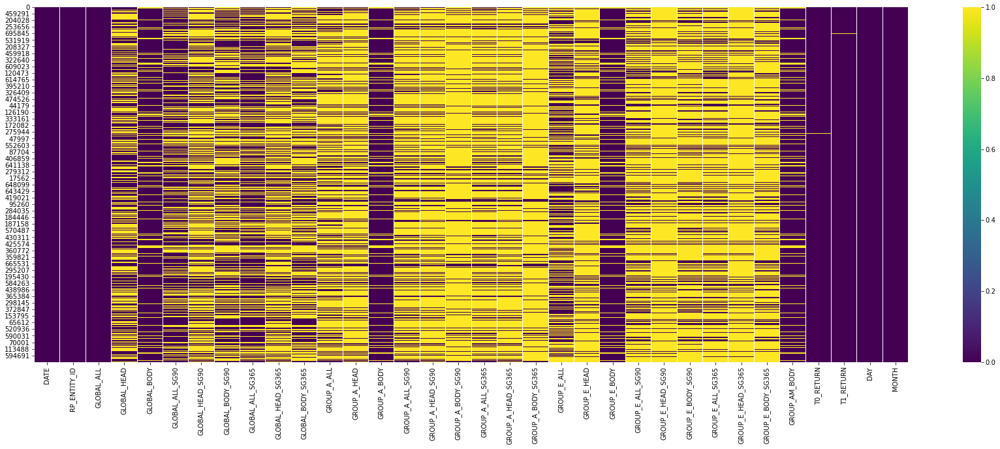

In [120]:
plt.figure(figsize=(30,10))
sns.heatmap(df.sort_values(by=['MONTH'], ascending=True).isna(),cmap='viridis');
#Missing values: no evident Saisonal structure

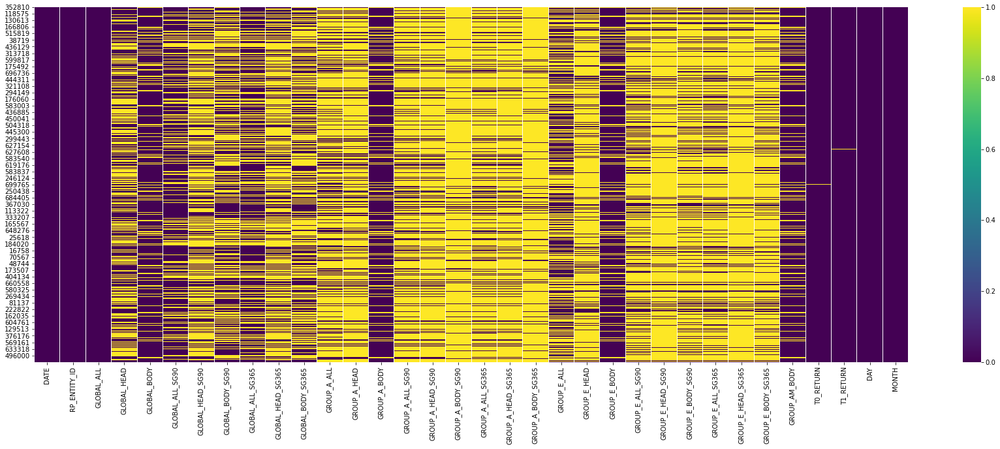

In [121]:
plt.figure(figsize=(30,10))
sns.heatmap(df.sort_values(by=['DAY'], ascending=True).isna(),cmap='viridis');
#Missing values: no evident Saisonal structure

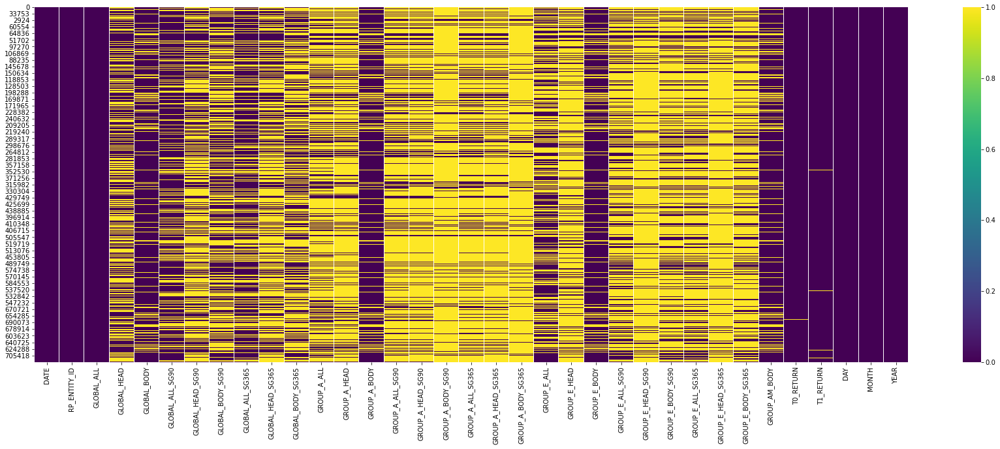

In [124]:
plt.figure(figsize=(30,10))
sns.heatmap(df.sort_values(by=['YEAR'], ascending=True).isna(),cmap='viridis');
#Missing values: no evident Saisonal structure

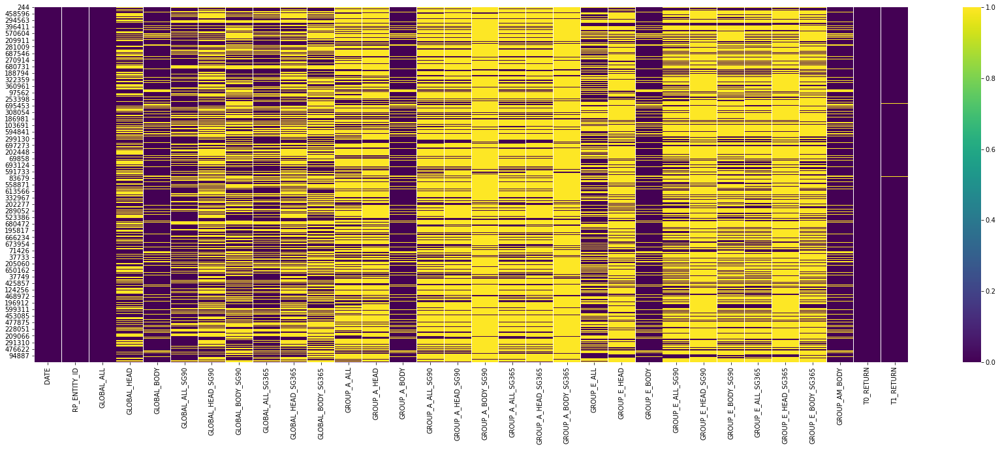

In [112]:
plt.figure(figsize=(30,10))
sns.heatmap(df.sort_values(by=['RP_ENTITY_ID','DATE'], ascending=True).isna(),cmap='viridis');
#Missing values: no evident assets structure

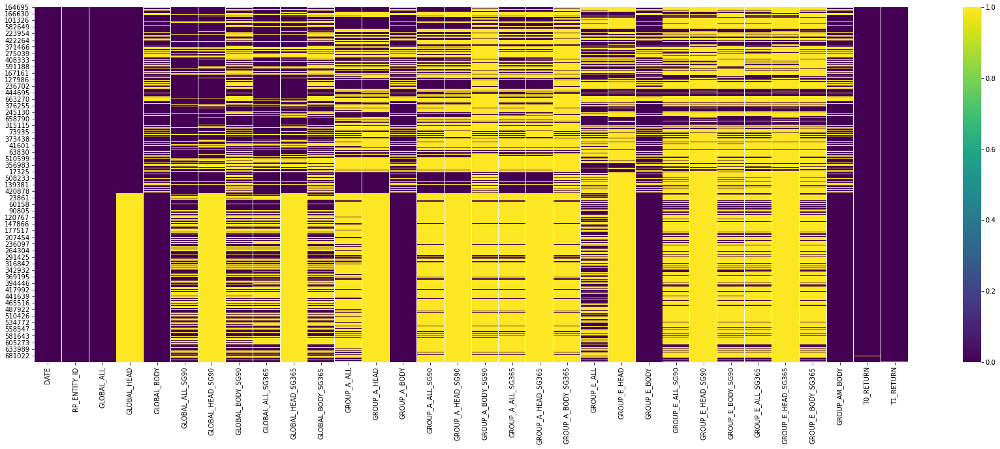

In [86]:
sorted_df = df.sort_values(by=['GLOBAL_HEAD'], ascending=True)

plt.figure(figsize=(30,10))
sns.heatmap(sorted_df.isna(),cmap='viridis');

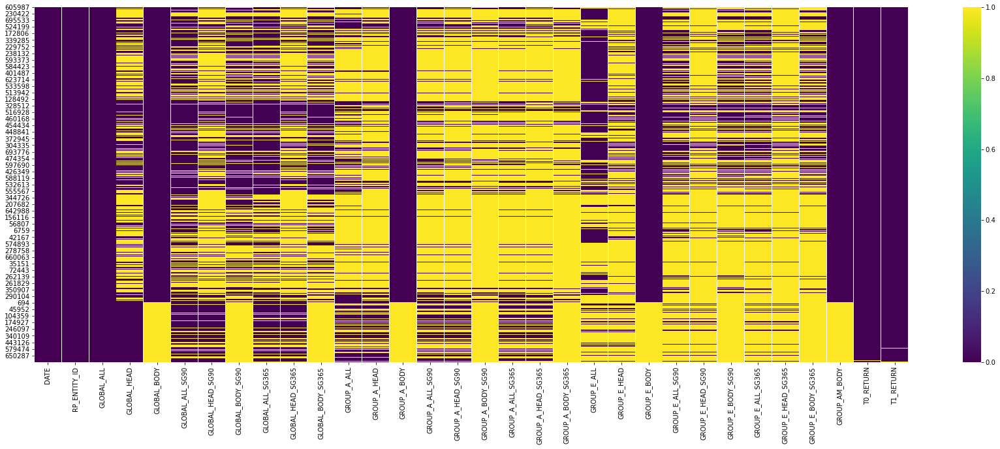

In [87]:
sorted_df = df.sort_values(by=['GLOBAL_BODY'], ascending=True)

plt.figure(figsize=(30,10))
sns.heatmap(sorted_df.isna(),cmap='viridis');

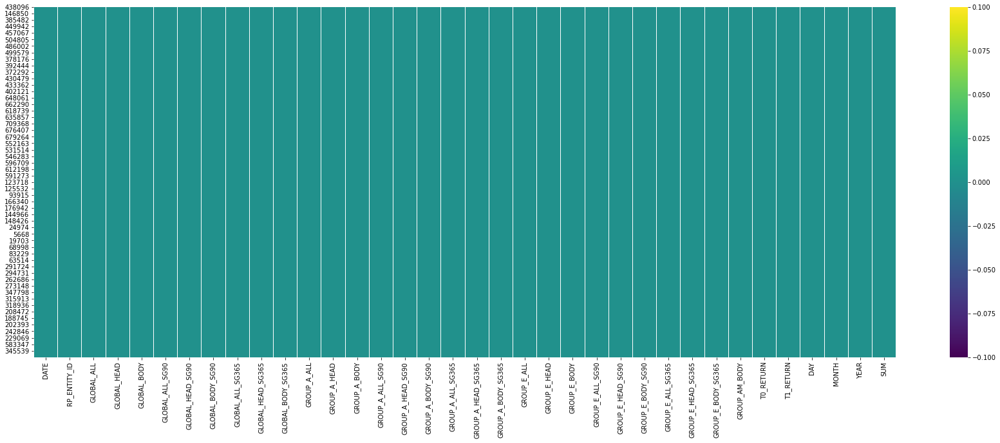

In [167]:
sorted_df = df.sort_values(by=['GROUP_A_BODY_SG365'], ascending=True)

plt.figure(figsize=(30,10))
sns.heatmap(sorted_df.isna(),cmap='viridis');

In [ ]:
y1 = pd.DataFrame(pd.DataFrame(dico_y['optim'])['y1'])
slots = pd.DataFrame(dico_y_slot['optim'])[1:-1]
data_pairplot = pd.merge(y1, slots, left_index=True, right_index=True)

<ipython-input-45-a454c461ee65>:17: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(corr, dtype=np.bool)


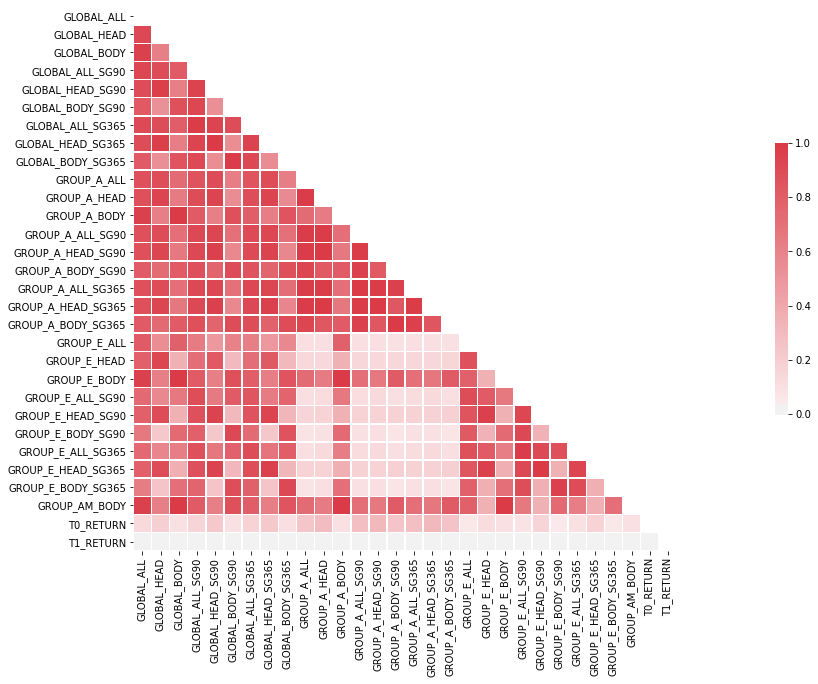

In [45]:
# df = df.groupby(['DATE','RP_ENTITY_ID'], as_index=False).first()
# df = df.groupby(['RP_ENTITY_ID', 'DATE'], as_index=False).first()

# df.sort_values(by=['RP_ENTITY_ID','DATE'])
df = pd.read_csv('./SampleDataSet.csv')
df['DATE'] = pd.to_datetime(df['DATE'])
df = df.groupby(['RP_ENTITY_ID', 'DATE'], as_index=False).first()
###col with 100% NA
cols_to_drop = descr.columns[descr.loc['count',:]==0]
###delete these cols
df = df.loc[:, ~df.columns.isin(cols_to_drop)]


f, ax = plt.subplots(figsize=(35, 10))
corr = df.iloc[:,2:].corr()

mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
cmap=sns.diverging_palette(220, 10, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

<ipython-input-159-cc6f06c5c2cb>:16: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



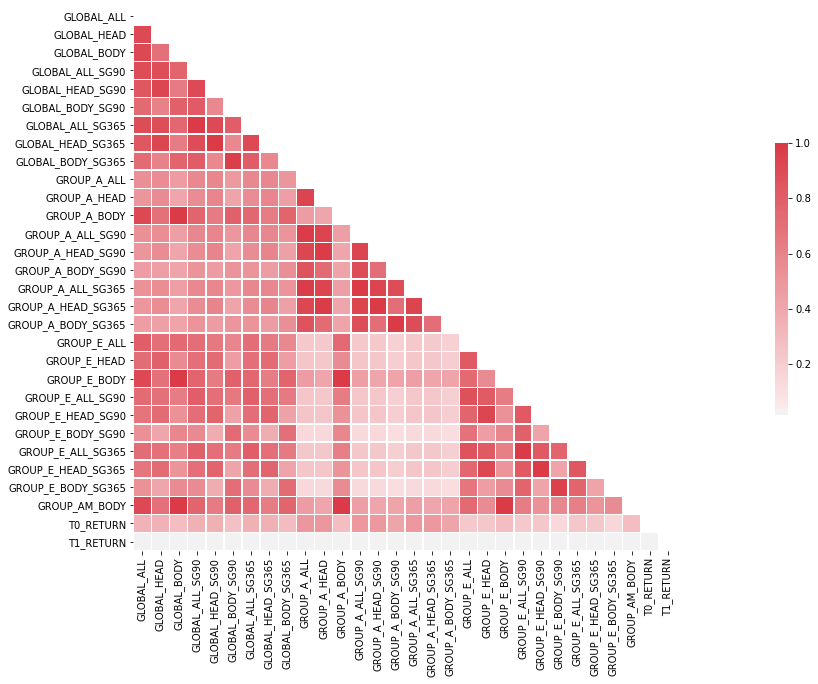

In [159]:
df = pd.read_csv('./SampleDataSet.csv')
df['DATE'] = pd.to_datetime(df['DATE'])
df = df.groupby(['RP_ENTITY_ID', 'DATE'], as_index=False).first()
###col with 100% NA
cols_to_drop = descr.columns[descr.loc['count',:]==0]
###delete these cols
df = df.loc[:, ~df.columns.isin(cols_to_drop)]


f, ax = plt.subplots(figsize=(35, 10))
retained_cols = ['GROUP_A_ALL','GROUP_A_HEAD','GROUP_A_BODY','GROUP_E_ALL','GROUP_E_HEAD','T0_RETURN', 'T1_RETURN']

dfna = df.dropna()
corr = dfna.iloc[:,2:].corr()

mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
cmap=sns.diverging_palette(220, 10, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

In [63]:
# corr = data_pairplot.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2).set_properties(**{'font-size': '12pt'})

,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,GLOBAL_BODY_SG365,GROUP_A_ALL,GROUP_A_HEAD,GROUP_A_BODY,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GROUP_A_BODY_SG90,GROUP_A_ALL_SG365,GROUP_A_HEAD_SG365,GROUP_A_BODY_SG365,GROUP_E_ALL,GROUP_E_HEAD,GROUP_E_BODY,GROUP_E_ALL_SG90,GROUP_E_HEAD_SG90,GROUP_E_BODY_SG90,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GROUP_E_BODY_SG365,GROUP_AM_BODY,T0_RETURN,T1_RETURN
GLOBAL_ALL,1.00,0.91,0.91,0.90,0.84,0.74,0.89,0.84,0.73,0.53,0.51,0.91,0.52,0.50,0.46,0.52,0.50,0.46,0.80,0.72,0.91,0.73,0.68,0.53,0.72,0.68,0.52,0.91,0.34,0.03
GLOBAL_HEAD,0.91,1.00,0.70,0.88,0.93,0.60,0.88,0.93,0.60,0.55,0.56,0.70,0.55,0.55,0.45,0.54,0.55,0.45,0.70,0.78,0.70,0.69,0.73,0.41,0.69,0.73,0.41,0.70,0.35,0.04
GLOBAL_BODY,0.91,0.70,1.00,0.77,0.64,0.79,0.75,0.63,0.76,0.46,0.42,1.00,0.45,0.41,0.43,0.45,0.41,0.42,0.74,0.56,1.00,0.63,0.52,0.58,0.62,0.52,0.56,1.00,0.28,0.03
GLOBAL_ALL_SG90,0.90,0.88,0.77,1.00,0.91,0.82,0.99,0.90,0.81,0.57,0.55,0.77,0.58,0.55,0.51,0.58,0.55,0.51,0.72,0.70,0.77,0.80,0.71,0.57,0.80,0.71,0.56,0.77,0.35,0.03
GLOBAL_HEAD_SG90,0.84,0.93,0.64,0.91,1.00,0.57,0.91,0.99,0.57,0.58,0.59,0.64,0.59,0.60,0.47,0.58,0.59,0.47,0.66,0.73,0.64,0.71,0.77,0.38,0.71,0.77,0.38,0.64,0.36,0.03
GLOBAL_BODY_SG90,0.74,0.60,0.79,0.82,0.57,1.00,0.80,0.57,0.97,0.48,0.43,0.79,0.49,0.42,0.51,0.49,0.42,0.51,0.59,0.46,0.79,0.66,0.43,0.73,0.65,0.43,0.71,0.79,0.27,0.03
GLOBAL_ALL_SG365,0.89,0.88,0.75,0.99,0.91,0.80,1.00,0.91,0.81,0.57,0.55,0.75,0.58,0.55,0.51,0.58,0.55,0.51,0.71,0.70,0.75,0.79,0.72,0.55,0.80,0.71,0.56,0.75,0.36,0.03
GLOBAL_HEAD_SG365,0.84,0.93,0.63,0.90,0.99,0.57,0.91,1.00,0.57,0.58,0.59,0.63,0.58,0.59,0.47,0.58,0.60,0.46,0.65,0.73,0.63,0.70,0.77,0.38,0.71,0.77,0.38,0.63,0.35,0.03
GLOBAL_BODY_SG365,0.73,0.60,0.76,0.81,0.57,0.97,0.81,0.57,1.00,0.50,0.45,0.76,0.51,0.44,0.54,0.51,0.44,0.53,0.58,0.46,0.76,0.65,0.43,0.70,0.65,0.43,0.73,0.76,0.29,0.02
GROUP_A_ALL,0.53,0.55,0.46,0.57,0.58,0.48,0.57,0.58,0.50,1.00,0.94,0.46,0.98,0.93,0.86,0.97,0.93,0.86,0.23,0.24,0.46,0.24,0.24,0.14,0.24,0.24,0.14,0.46,0.50,0.03


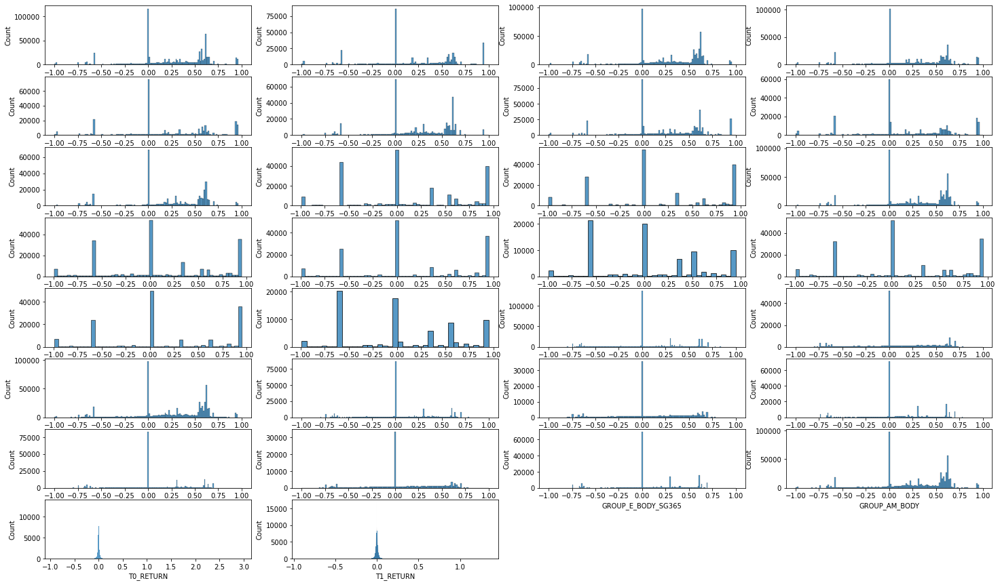

In [84]:
cols = df.columns[2:]

fig = plt.figure(figsize=(25, 15))
fig.subplots_adjust(hspace=0.2, wspace=0.2)

for i,col in enumerate(cols):
    ax = fig.add_subplot(8, 4, i+1)
    sns.histplot(df[col], ax=ax)
plt.show()
    
    
    
    
#     sns.lineplot(x=range(len(y_slot_full)), y=y_slot_full, linewidth = 0.2, color=colorGraph[i], ax=ax2)
#     sns.histplot(y_slot_optim, binwidth=1, color=colorGraph[i], ax=ax3)
#     sns.lineplot(x=range(len(y_slot_optim)), y=y_slot_optim, linewidth = 0.2, color=colorGraph[i], ax=ax4)
# fig.suptitle('durée en jours', fontsize=20)


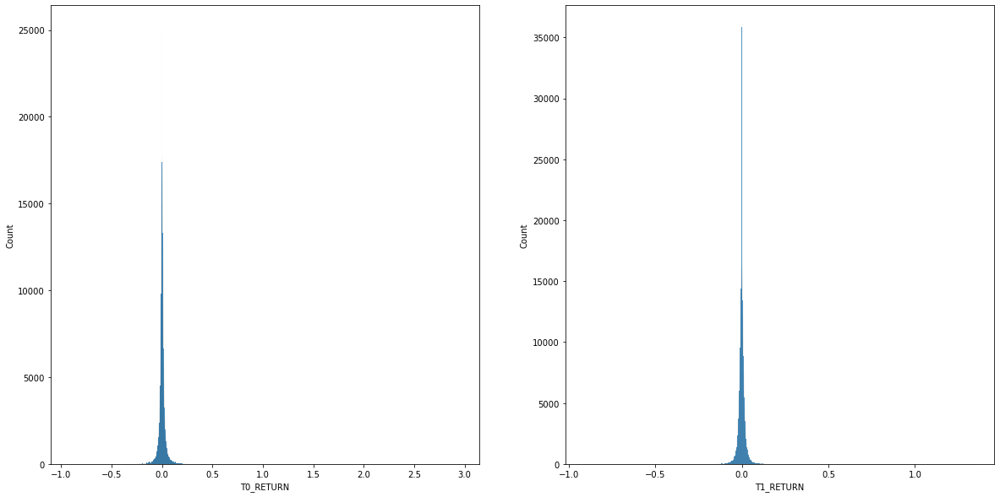

In [267]:
cols = ['T0_RETURN','T1_RETURN']

fig = plt.figure(figsize=(20, 10))
fig.subplots_adjust(hspace=0.2, wspace=0.2)

for i,col in enumerate(cols):
    ax = fig.add_subplot(1, 2, i+1)
    sns.histplot(df[col], ax=ax)
plt.show()

In [301]:
df['T1_RETURN'].max()
df['T0_RETURN'][df['T0_RETURN']<=1]

0          0.018520
1          0.018520
2         -0.001415
3         -0.005460
4         -0.005460
             ...   
1764819   -0.003989
1764820   -0.001759
1764821   -0.001759
1764822   -0.002900
1764823   -0.002900
Name: T0_RETURN, Length: 1761988, dtype: float64

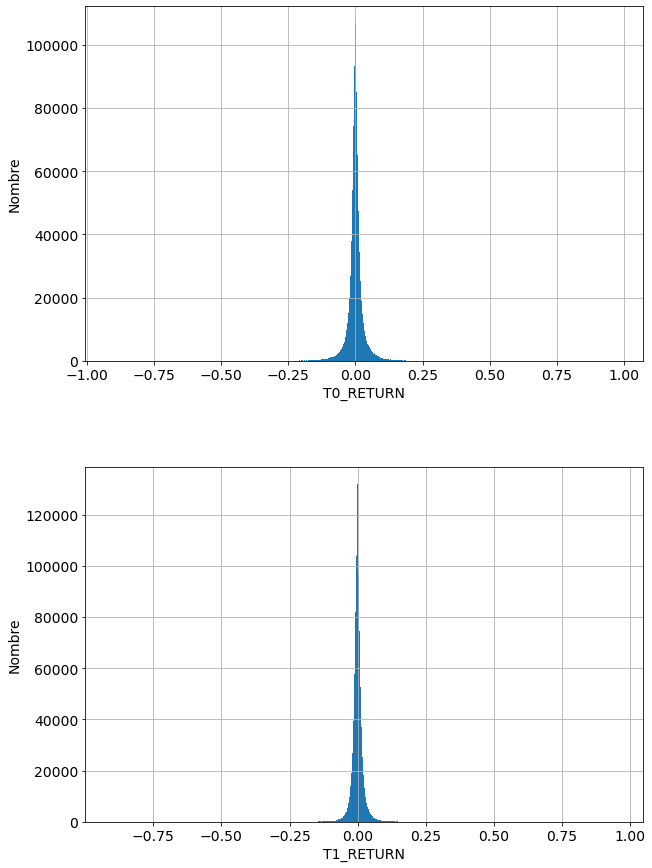

In [304]:
# fig = plt.figure(figsize=(100, 20))
# fig = plt.figure(figsize=(25, 15))
fig, (ax1, ax2) = plt.subplots(2,1, figsize=(10, 15))
fig.subplots_adjust(hspace=0.3, wspace=0.3)
df['T0_RETURN'][df['T0_RETURN']<=1].hist(ax=ax1, bins=1000)
ax1.tick_params(labelsize=14)
ax1.set_xlabel('T0_RETURN', fontsize=14)
ax1.set_ylabel('Nombre', fontsize=14)
df['T1_RETURN'][df['T1_RETURN']<=1].hist(ax=ax2, bins=1000)
ax2.tick_params(labelsize=14)
ax2.set_xlabel('T1_RETURN', fontsize=14)
ax2.set_ylabel('Nombre', fontsize=14)
plt.show();

In [338]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)
df[['T0_RETURN','T1_RETURN']].describe([0.005,0.01,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45,0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95,0.99,0.995])

,T0_RETURN,T1_RETURN
count,711495.000,710458.000
mean,0.000,-0.000
std,0.028,0.023
min,-0.911,-0.906
0.5%,-0.103,-0.082
1%,-0.076,-0.060
5%,-0.032,-0.028
10%,-0.020,-0.018
15%,-0.015,-0.014
20%,-0.011,-0.010


In [339]:
df4=pd.DataFrame()
df4['T0_RETURN']=df['T0_RETURN'][df['T0_RETURN']<df['T0_RETURN'].quantile(0.999)]
df4['T1_RETURN']=df['T1_RETURN']#[df['T1_RETURN']<df['T1_RETURN'].quantile(0.999)]

df4[['T0_RETURN','T1_RETURN']].describe([0.005,0.01,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45,0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95,0.99,0.995])

,T0_RETURN,T1_RETURN
count,710783.000,708510.000
mean,-0.000,-0.000
std,0.026,0.023
min,-0.911,-0.906
0.5%,-0.104,-0.081
1%,-0.076,-0.060
5%,-0.032,-0.027
10%,-0.020,-0.018
15%,-0.015,-0.014
20%,-0.011,-0.010


In [328]:
df['T0_RETURN'][df['T0_RETURN']>df['T0_RETURN'].quantile(0.99)].describe()

count   17617.000
mean        0.180
std         0.097
min         0.113
25%         0.128
50%         0.149
75%         0.193
max         2.956
Name: T0_RETURN, dtype: float64

In [330]:
df['T1_RETURN'][df['T1_RETURN']>df['T1_RETURN'].quantile(0.995)].describe()

count   8795.000
mean       0.149
std        0.086
min        0.090
25%        0.103
50%        0.123
75%        0.163
max        1.345
Name: T1_RETURN, dtype: float64

In [ ]:
df[df['RP_ENTITY_ID']=='42ABA7'].loc[df['T0_RETURN']>=0.01,:]

In [395]:
ret = 0.02
ent = '42ABA7'
critere=df.columns[2:-2]
RETURN = 'T0_RETURN'

for crit in critere:
    hausse_mean = df[crit].loc[(df['RP_ENTITY_ID']==ent)&(df[RETURN]>=ret)].mean()
    hausse_std = df[crit].loc[(df['RP_ENTITY_ID']==ent)&(df[RETURN]>=ret)].std()
    baisse_mean = df[crit].loc[(df['RP_ENTITY_ID']=='42ABA7')&(df[RETURN]<=ret)].mean()
    baisse_std = df[crit].loc[(df['RP_ENTITY_ID']=='42ABA7')&(df[RETURN]<=ret)].std()
    print('=>entity:',ent, '=>criterion:', crit, '=>return:',RETURN, '=>trigger:',ret)
    print(hausse_mean,baisse_mean)
    print(hausse_std,baisse_std)
    print()

=>entity: 42ABA7 =>criterion: GLOBAL_ALL =>return: T0_RETURN =>trigger: 0.02
0.06071694374748549 0.03789834427037883
0.19208957433424656 0.1676974115922237

=>entity: 42ABA7 =>criterion: GLOBAL_HEAD =>return: T0_RETURN =>trigger: 0.02
0.029999215227425904 0.006119061942834314
0.13298268134732857 0.1121950993127638

=>entity: 42ABA7 =>criterion: GLOBAL_BODY =>return: T0_RETURN =>trigger: 0.02
0.10624450084051393 0.08732314205118466
0.29211907349902355 0.27666471121058706

=>entity: 42ABA7 =>criterion: GLOBAL_ALL_SG90 =>return: T0_RETURN =>trigger: 0.02
0.05502092074535052 0.03021487043126525
0.18555548877953815 0.14988918995902226

=>entity: 42ABA7 =>criterion: GLOBAL_HEAD_SG90 =>return: T0_RETURN =>trigger: 0.02
0.026388272331838568 0.004350284808193142
0.12305005680732484 0.10647394549497406

=>entity: 42ABA7 =>criterion: GLOBAL_BODY_SG90 =>return: T0_RETURN =>trigger: 0.02
0.14952479608578176 0.10699017988824659
0.357048922412161 0.3183888788512509

=>entity: 42ABA7 =>criterion: GLOB

In [371]:
ret = 0.04
hausse = df['GLOBAL_HEAD'].loc[(df['RP_ENTITY_ID']=='42ABA7')&(df['T0_RETURN']>=ret)].mean()
baisse = df['GLOBAL_HEAD'].loc[(df['RP_ENTITY_ID']=='42ABA7')&(df['T0_RETURN']<=ret)].mean()
print(hausse,baisse)

0.05036151832019782 0.0073920108313171515


Index(['GLOBAL_ALL', 'GLOBAL_HEAD', 'GLOBAL_BODY', 'GLOBAL_ALL_SG90',
       'GLOBAL_HEAD_SG90', 'GLOBAL_BODY_SG90', 'GLOBAL_ALL_SG365',
       'GLOBAL_HEAD_SG365', 'GLOBAL_BODY_SG365', 'GROUP_A_ALL', 'GROUP_A_HEAD',
       'GROUP_A_BODY', 'GROUP_A_ALL_SG90', 'GROUP_A_HEAD_SG90',
       'GROUP_A_BODY_SG90', 'GROUP_A_ALL_SG365', 'GROUP_A_HEAD_SG365',
       'GROUP_A_BODY_SG365', 'GROUP_E_ALL', 'GROUP_E_HEAD', 'GROUP_E_BODY',
       'GROUP_E_ALL_SG90', 'GROUP_E_HEAD_SG90', 'GROUP_E_BODY_SG90',
       'GROUP_E_ALL_SG365', 'GROUP_E_HEAD_SG365', 'GROUP_E_BODY_SG365',
       'GROUP_AM_ALL', 'GROUP_AM_HEAD', 'GROUP_AM_BODY', 'GROUP_AM_ALL_SG90',
       'GROUP_AM_HEAD_SG90', 'GROUP_AM_BODY_SG90', 'GROUP_AM_ALL_SG365',
       'GROUP_AM_HEAD_SG365', 'GROUP_AM_BODY_SG365'],
      dtype='object')

In [24]:
df.fillna(0, inplace=True)

In [25]:
df.describe()

,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,GLOBAL_BODY_SG365,GROUP_A_ALL,GROUP_A_HEAD,GROUP_A_BODY,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GROUP_A_BODY_SG90,GROUP_A_ALL_SG365,GROUP_A_HEAD_SG365,GROUP_A_BODY_SG365,GROUP_E_ALL,GROUP_E_HEAD,GROUP_E_BODY,GROUP_E_ALL_SG90,GROUP_E_HEAD_SG90,GROUP_E_BODY_SG90,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GROUP_E_BODY_SG365,GROUP_AM_BODY,T0_RETURN,T1_RETURN
count,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000,712758.000000
mean,0.244088,0.104871,0.213691,0.158057,0.074144,0.122060,0.138039,0.067708,0.103859,0.036205,0.037208,0.213691,0.034235,0.033194,0.005972,0.032176,0.031311,0.005522,0.055465,0.019818,0.213691,0.035918,0.015441,0.033182,0.031269,0.014290,0.028666,0.213691,0.000296,-0.000071
std,0.411034,0.357134,0.372704,0.377104,0.328672,0.307787,0.368005,0.321140,0.296388,0.338323,0.302746,0.372704,0.306224,0.288039,0.187327,0.300138,0.282219,0.182557,0.274036,0.181046,0.372704,0.219955,0.155569,0.201732,0.209310,0.151441,0.191614,0.372704,0.028176,0.022874
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.990000,-0.990000,-1.000000,-0.990000,-0.990000,-0.990000,-0.990000,-0.990000,-0.990000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.910788,-0.906011
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.008569,-0.008082
50%,0.305000,0.000000,0.180000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.180000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.180000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.180000,-0.000058,-0.000144
75%,0.587640,0.220000,0.570000,0.512807,0.000000,0.305000,0.414286,0.000000,0.218333,0.000000,0.000000,0.570000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.570000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.570000,0.008621,0.007580
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.950000,0.950000,1.000000,0.950000,0.950000,0.950000,0.950000,0.950000,0.950000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.955917,1.344644


In [12]:
ceiling = 10000
floor = 756
list_asset = df.RP_ENTITY_ID.value_counts().loc[(df.RP_ENTITY_ID.value_counts()<ceiling)&(df.RP_ENTITY_ID.value_counts()>floor)].index
list_asset

Index(['619882', '50070E', '9196A2', '990AD0', 'CFF97C', 'B3CB74', '228D42',
       '4A6F00', '1921DD', '8D4486',
       ...
       '4030E2', '61E975', '1D1B07', '56632F', '9AF3DC', 'FF4BA4', '43A74A',
       '095294', '91C82E', 'DE27F9'],
      dtype='object', length=256)

In [369]:
beg = '2005-01-03'

fig = go.Figure()
for asset in list_asset:
    df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
    df2 = df2[df2['DATE']>=beg]
    df2['PRICE'] = 100*(1 + df2['T0_RETURN']).cumprod()
    df2['PRICE'] = df2['PRICE'].shift(1)
#     df2['PRICE'].iloc[0]=100
    df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
    # fig = px.line(df, x="DATE", y="lifeExp", color='country')
    # fig.show()
#     print(df2)
#     dfp = df[df['country']==c].pivot(index='year', columns='country', values='pop') 
    fig.add_traces(go.Scatter(x=df2.DATE, y=df2.PRICE, mode='lines', name = asset))

fig.show()

In [260]:
# beg = '2005-01-03'
# freq = 'M'

# fig = go.Figure()
# for asset in list_asset:
#     df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
#     df2 = df2[df2['DATE']>=beg]
#     df2['PRICE'] = 100*(1 + df2['T0_RETURN']).cumprod()
#     df2['PRICE'] = df2['PRICE'].shift(1)
# #     df2['PRICE'].iloc[0]=100
#     df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
#     # fig = px.line(df, x="DATE", y="lifeExp", color='country')
#     # fig.show()
# #     print(df2)
# #     dfp = df[df['country']==c].pivot(index='year', columns='country', values='pop')

#     df2 = df2.set_index('DATE')
# #     # df2 = df2.dropna(subset='DATE')
#     df2 = df2.resample(freq).mean()
    
#     fig.add_traces(go.Scatter(x=df2.index, y=df2.PRICE, mode='lines', name = asset))

# fig.show()

In [231]:
# fig = go.Figure()
# for asset in list_asset:
#     df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
#     df2 = df2[df2['DATE']>=beg]
#     df2['PRICE'] = 100*(1 + df2['T0_RETURN']).cumprod()
#     df2['PRICE'] = df2['PRICE'].shift(1)
#     df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
#     df2 = df2.set_index('DATE')
#     df2 = df2.resample(freq).mean()
    
#     fig.add_traces(go.Scatter(x=df2.index, y=df2.PRICE, mode='lines', name = asset))
#     fig.update_yaxes(title_text="y-axis in logarithmic scale", type="log")

# fig.show()

In [241]:
###lissage exponentiel
# alpha=0.1

# fig = go.Figure()
# for asset in list_asset:
#     df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
#     df2 = df2[df2['DATE']>=beg]
#     df2['PRICE'] = 100*(1 + df2['T0_RETURN']).cumprod()
#     df2['PRICE'] = df2['PRICE'].shift(1)
#     df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
#     df2 = df2.set_index('DATE')
#     df2 = df2.ewm(alpha=alpha).mean()
    
#     fig.add_traces(go.Scatter(x=df2.index, y=df2.PRICE, mode='lines', name = asset))
#     fig.update_yaxes(title_text="ewm "+str(alpha), type="log")

# fig.show()

Series([], Name: PRICE, dtype: float64)

In [258]:
# fig = go.Figure()
# for asset in list_asset:
#     df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
#     df2 = df2[df2['DATE']>=beg]
#     df2['T0_RETURN_log'] = np.log(1+df2['T0_RETURN'])
#     df2['PRICE'] = np.exp(df2['T0_RETURN_log']).cumprod()*100
#     df2['PRICE'] = df2['PRICE'].shift(1)
#     df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
#     df2 = df2.set_index('DATE')
#     df2 = df2.ewm(alpha=alpha).mean()
    
#     fig.add_traces(go.Scatter(x=df2.index, y=df2.PRICE, mode='lines', name = asset))
#     fig.update_yaxes(title_text="ewm "+str(alpha), type="log")

# fig.show()

619882    3093
50070E    3092
9196A2    3083
990AD0    3027
CFF97C    3003
          ... 
9F2C11       1
CB6A9C       1
B09F19       1
DDC25F       1
AA1F21       1
Name: RP_ENTITY_ID, Length: 1768, dtype: int64

___
# <a id =4> </a> **4. Preprocess the data**
___

Strategy: We implemented a trading strategy in simulation as follows: On the first trading day of each week, we compute a forecast for each member of the S&P 500. We assess each decile (groups of 50) of stocks ranked from highest forecast to lowest, as follows: We enter an equally-weighted long position in each group of 50 stocks. Positions are held one week, and then rebalanced.

Reversion
Momentum
Seasonality
Lead-lag
Learning...


Events: 
=> entity detection: companies, people, products, commo, fx, orga...
=> envent detection: 5 broader topics: business, economic, societal, political, environmental
- Event relevance 
- Novel event (first time you see a particuliar event since a certain time)
- Event buzz (abnormal news volume)
- Sentiment scoring

## <a id =4.1> </a>4.1 Clustering

In [ ]:
import tslearn
from tslearn import TimeSeriesKMeans
from tslearn.generators import random_walks
X = random_walks(n_ts=50, sz=32, d=1)
km = TimeSeriesKMeans(n_clusters=3, metric="euclidean", max_iter=5, random_state=0).fit(X)
km.cluster_centers_.shape
# (3, 32, 1)
km_dba = TimeSeriesKMeans(n_clusters=3, metric="dtw", max_iter=5, max_iter_barycenter=5, random_state=0).fit(X)
km_dba.cluster_centers_.shape

In [ ]:
# Native libraries
import os
import math
# Essential Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
# Preprocessing
from sklearn.preprocessing import MinMaxScaler
# Algorithms
from minisom import MiniSom
from tslearn.barycenters import dtw_barycenter_averaging
from tslearn.clustering import TimeSeriesKMeans
from sklearn.cluster import KMeans

from sklearn.decomposition import PCA

n order to cluster our series with k-means, the essential thing to do is, as we do it with som, removing our time indices from our time series, and instead of measured values of each date, we should accept them as different features and dimensions of a single data point. Another important thing to do is, selecting the distance metric. In the k-means algorithm, people usually use the euclidean distance but as we've seen in DBA, it is not effective in our case. So, we will be using Dynamic Time Warping (DTW) instead of euclidean distance and you can see why we are doing this in the following images.

Dynamic Time Warping Distance Metric for Time Series But first, why is the common Euclidean distance metric is unsuitable for time series? In short, it is invariant to time shifts, ignoring the time dimension of the data. If two time series are highly correlated, but one is shifted by even one time step, Euclidean distance would erroneously measure them as further apart. Instead, it is better to use dynamic time warping (DTW) to compare series. DTW is a technique to measure similarity between two temporal sequences that do not align exactly in time, speed, or length.

In [ ]:
from tslearn.utils import to_sklearn_dataset
to_sklearn_dataset([[1, 2], [1, 4, 3]])
# to_time_series_dataset([[ 1.,  2., None], [ 1.,  4.,  3.]])

In [ ]:
ceiling = 1000
floor = 756
list_asset = df.RP_ENTITY_ID.value_counts().loc[(df.RP_ENTITY_ID.value_counts()<ceiling)&(df.RP_ENTITY_ID.value_counts()>floor)].index
list_asset

In [ ]:
from tslearn.metrics import dtw
A1 = '619882'
A2 = '50070E'
x = df['T0_RETURN'][df['RP_ENTITY_ID']==A1]
y =  df[df['RP_ENTITY_ID']==A1]
dtw_score = dtw(x, y)

In [ ]:
from tslearn.metrics import dtw, dtw_path

dtw_score = dtw(x, y)
# Or, if the path is also an important information:
optimal_path, dtw_score = dtw_path(x, y)

In [ ]:
A1 = '902670'
A2 = '86A1B9'
df['T0_RETURN'][df['RP_ENTITY_ID']==A2]

In [ ]:
df.RP_ENTITY_ID.value_counts()

In [396]:
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import mean_squared_error
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
# from IPython.display import display
from sklearn.model_selection import cross_val_score
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost.sklearn import XGBClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.ensemble import VotingClassifier

In [381]:
non_target_cols

['GLOBAL_BODY_SG365',
 'GROUP_E_ALL_SG365',
 'GROUP_E_HEAD_SG365',
 'GLOBAL_HEAD',
 'GROUP_AM_BODY',
 'GROUP_A_BODY',
 'GROUP_A_BODY_SG365',
 'GROUP_E_BODY_SG90',
 'GROUP_A_HEAD_SG365',
 'GLOBAL_HEAD_SG90',
 'GROUP_A_ALL',
 'GROUP_A_HEAD',
 'GROUP_E_ALL_SG90',
 'GROUP_A_ALL_SG365',
 'GLOBAL_ALL_SG365',
 'GLOBAL_ALL',
 'GLOBAL_ALL_SG90',
 'T0_RETURN',
 'GROUP_E_HEAD',
 'GROUP_A_BODY_SG90',
 'GROUP_A_ALL_SG90',
 'GROUP_A_HEAD_SG90',
 'GLOBAL_HEAD_SG365',
 'GROUP_E_ALL',
 'GLOBAL_BODY_SG90',
 'GROUP_E_BODY_SG365',
 'GROUP_E_HEAD_SG90',
 'GROUP_E_BODY',
 'GLOBAL_BODY']

In [263]:
X

,GLOBAL_BODY_SG365,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GLOBAL_HEAD,GROUP_AM_BODY,GROUP_A_BODY,GROUP_A_BODY_SG365,GROUP_E_BODY_SG90,GROUP_A_HEAD_SG365,GLOBAL_HEAD_SG90,GROUP_A_ALL,GROUP_A_HEAD,GROUP_E_ALL_SG90,GROUP_A_ALL_SG365,GLOBAL_ALL_SG365,GLOBAL_ALL,GLOBAL_ALL_SG90,T0_RETURN,GROUP_E_HEAD,GROUP_A_BODY_SG90,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GLOBAL_HEAD_SG365,GROUP_E_ALL,GLOBAL_BODY_SG90,GROUP_E_BODY_SG365,GROUP_E_HEAD_SG90,GROUP_E_BODY,GLOBAL_BODY
0,0.61,0.61,0.0,0.000000,0.610000,0.610000,0.0,0.61,0.00,0.00,0.00,0.00,0.61,0.00,0.61,0.610000,0.61,0.018520,0.0,0.0,0.00,0.00,0.00,0.61,0.61,0.61,0.0,0.610000,0.610000
1,0.00,0.00,0.0,0.010000,0.000000,0.000000,0.0,0.00,0.01,0.01,0.01,0.01,0.00,0.01,0.01,0.010000,0.01,-0.001415,0.0,0.0,0.01,0.01,0.01,0.00,0.00,0.00,0.0,0.000000,0.000000
2,0.00,0.70,0.7,0.633333,0.000000,0.000000,0.0,0.00,0.00,0.66,0.00,0.00,0.70,0.00,0.70,0.633333,0.66,-0.005460,0.7,0.0,0.00,0.00,0.70,0.70,0.00,0.00,0.7,0.000000,0.000000
3,0.55,0.00,0.0,0.000000,0.550000,0.550000,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.55,0.550000,0.55,0.018809,0.0,0.0,0.00,0.00,0.00,0.00,0.55,0.00,0.0,0.550000,0.550000
4,0.00,0.00,0.0,0.000000,0.000000,0.000000,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,-0.002185,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
712753,0.22,0.00,0.0,0.000000,0.220000,0.220000,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.22,0.220000,0.22,0.036429,0.0,0.0,0.00,0.00,0.00,0.00,0.22,0.00,0.0,0.220000,0.220000
712754,0.70,0.70,0.0,0.000000,0.635000,0.635000,0.0,0.70,0.00,0.00,0.00,0.00,0.70,0.00,0.70,0.635000,0.70,0.023102,0.0,0.0,0.00,0.00,0.00,0.70,0.70,0.70,0.0,0.635000,0.635000
712755,0.00,0.00,0.0,0.220000,0.000000,0.000000,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.220000,0.00,-0.003989,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.000000,0.000000
712756,0.00,0.00,0.0,0.000000,-0.386667,-0.386667,0.0,0.00,0.00,0.00,-0.58,0.00,0.00,0.00,0.00,-0.386667,0.00,-0.001759,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,-0.386667,-0.386667


In [370]:
list_asset = df.RP_ENTITY_ID.value_counts().loc[(df.RP_ENTITY_ID.value_counts()<2600)&(df.RP_ENTITY_ID.value_counts()>2200)].index

In [399]:
list_asset = df.RP_ENTITY_ID.value_counts().index.values[:35]

for asset in list_asset:
    print(asset)
#     dg= df.sort_values(['DATE','RP_ENTITY_ID'], ignore_index = True).loc[df['RP_ENTITY_ID']==asset, :]


TypeError: unsupported operand type(s) for +: 'set' and 'set'

___
# <a id =5> </a> **5. Create features**
___

## <a id =5.1> </a> 5.1 Check if the data is stationary

In [ ]:
from statsmodels.tsa.stattools import adfuller
from numpy import log



list_asset = df.RP_ENTITY_ID.value_counts().loc[df.RP_ENTITY_ID.value_counts()>10000].index
list_asset


dg = df.loc[df['RP_ENTITY_ID'].isin(list_asset),'T0_RETURN'].dropna()
result = adfuller(dg)
print('p-value: %f' % result[1])


Since the p-value is below 0.05, the data can be assumed to be stationary hence we can proceed with the data without any transformation

## <a id =5.2> </a> 5.2 Create lag variables

In [ ]:
!jupyter notebook --NotebookApp.iopub_data_rate_limit=1e10

In [ ]:
df.RP_ENTITY_ID.value_counts().loc[df.RP_ENTITY_ID.value_counts()>=2500].index

In [ ]:
import time
lag=10
cols=df.columns[2:-2]
list_asset = df.RP_ENTITY_ID.value_counts().loc[df.RP_ENTITY_ID.value_counts()>=lag+1500].index

start_time = time.time()


count=0    
final_data = []
for asset in list_asset:
    df_temp = df.loc[df['RP_ENTITY_ID']==asset, :]
    dataframe_to_append = pd.DataFrame()
    for col in cols:
        for i in range(lag,0,-1):
            dataframe_to_append[str(col)+'_t-' + str(i)] = df_temp.loc[:, str(col)].shift(i)
    final_data.append(dataframe_to_append)
    elapsed_time = time.time() - start_time
    count+=1
    print(f"Elapsed time to compute the tab_values{count:.0f}: {elapsed_time:.3f} seconds")

# final_data

In [ ]:
final_data = pd.concat(final_data)

In [ ]:
final_tab = final_data.dropna()
final_tab

In [ ]:
len(final_data.loc[final_data['GLOBAL_ALL_t-10'].isna(),:])

In [ ]:
final_tab.join(df)

___
#  <a id =6> </a> **6. Select a ML algo**
___

In [401]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import accuracy_score

target_cols = ['T1_RETURN']
non_target_cols = list(set(df.columns) - set(['RP_ENTITY_ID'] + ['DATE']))#list(set(df.columns) - set(target_cols + ['RP_ENTITY_ID'] + ['DATE']))
non_target_cols

dg= df.sort_values(['DATE','RP_ENTITY_ID'], ignore_index = True).loc[df['RP_ENTITY_ID'].isin(list_asset), :]
X = dg.loc[:,non_target_cols]
y = dg.loc[:,target_cols]
tscv = TimeSeriesSplit()
print(tscv)

count=0
for train_index, test_index in tscv.split(X):
    start_time = time.time()
#     print("TRAIN:", train_index, "TEST:", test_index)
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
#     for mf in np.linspace(100, 150, 6):
#         for ne in np.linspace(50, 100, 6):
#             for md in np.linspace(20, 40, 5):
#                 for msl in np.linspace(30, 100, 8):
#                     print(i,
#                                   mf, 
#                                   ne,
#                                   md, 
#                                   msl, )
#                     rfr = RandomForestRegressor(
#                         max_features=int(mf),
#                         n_estimators=int(ne),
#                         max_depth=int(md),
#                         min_samples_leaf=int(msl))
#                     rfr.fit(X_train, y_train)
#                     score.append([i,
#                                   mf, 
#                                   ne,
#                                   md, 
#                                   msl, 
#                                   rfr.score(X_test, y_test)])

    rfr = RandomForestRegressor(n_estimators=100)
    rfr.fit(X_train, y_train.values.ravel())
    print(rfr.score(X_test, y_test.values.ravel()))
    elapsed_time = time.time() - start_time
    count+=1
    print(f"Elapsed time to compute the tab_values{count:.0f}: {elapsed_time:.3f} seconds")


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.9505696483781951
Elapsed time to compute the tab_values1: 3.900 seconds
0.9999827932023081
Elapsed time to compute the tab_values2: 11.265 seconds
0.9999736679197753
Elapsed time to compute the tab_values3: 21.615 seconds
0.999995159227132
Elapsed time to compute the tab_values4: 33.721 seconds
0.9999887270604849
Elapsed time to compute the tab_values5: 43.511 seconds


In [ ]:
np.sign(df['T1_RETURN'])
df['T0_RETURN'].describe()

In [ ]:
df['T1_RETURN'].loc[mask].count()/df['T1_RETURN'].count()

np.sign(df['T1_RETURN'])

In [173]:
mean_score_dico

{'619882': (0.5130097087378641, 0.02245217789446564, 0.5184466019417475, 515),
 '50070E': (0.4974757281553398, 0.037511427234309114, 0.487378640776699, 515),
 '9196A2': (0.5056530214424951, 0.02246371975187204, 0.5048732943469786, 513),
 '990AD0': (0.5099206349206349, 0.02275266853408673, 0.5138888888888888, 504),
 'CFF97C': (0.5016, 0.018077610461562685, 0.5, 500),
 'B3CB74': (0.5052192066805845, 0.011623725183361229, 0.5031315240083507, 479),
 '228D42': (0.5023255813953489, 0.01810051145285748, 0.4989429175475687, 473),
 '4A6F00': (0.49639065817409767,
  0.03742395820951813,
  0.47983014861995754,
  471),
 '1921DD': (0.52, 0.02120216351632899, 0.5161290322580645, 465),
 '8D4486': (0.4856521739130435, 0.01564613410038835, 0.48043478260869565, 460),
 '3461CF': (0.49671772428884026,
  0.035452629641180844,
  0.49452954048140046,
  457),
 'D91D4E': (0.5040909090909091,
  0.016341525465679595,
  0.49772727272727274,
  440),
 'D8442A': (0.4912442396313364, 0.04161522517009946, 0.4815668202

In [174]:
{k: v for k, v in sorted(mean_score_dico.items(), key=lambda item: item[1])}

{'F4E882': (0.4358620689655172, 0.01495136785426125, 0.43448275862068964, 145),
 '4A5C8D': (0.4553846153846154,
  0.027947541730130684,
  0.46923076923076923,
  130),
 '96B4C5': (0.4593406593406593,
  0.029741469456537054,
  0.46153846153846156,
  182),
 '6E705B': (0.46060606060606063,
  0.02479276374593309,
  0.46320346320346323,
  231),
 '99333F': (0.46216216216216216, 0.06867338349876707, 0.4527027027027027, 148),
 '1D1B07': (0.46299212598425193,
  0.03792628213792848,
  0.47244094488188976,
  127),
 '4030E2': (0.462992125984252, 0.07662513779970306, 0.4251968503937008, 127),
 '986AF6': (0.46308724832214765,
  0.06349291251149161,
  0.44966442953020136,
  149),
 '28DEFA': (0.4631578947368421, 0.0378188762104039, 0.46616541353383456, 133),
 '131443': (0.46564885496183206,
  0.029067836281923307,
  0.4580152671755725,
  131),
 '143C52': (0.4666666666666667, 0.045137424644630254, 0.4420289855072464, 138),
 '9803B7': (0.4666666666666667, 0.06864118773973094, 0.4513888888888889, 144),
 '

In [175]:
mlist = [v[0] for v in mean_score_dico.values()]
print('mean:', round(statistics.mean(mlist),4), '--- median:', round(np.quantile(mlist,0.5),4), '--- min:', round(min(mlist),2), '--- max:', round(max(mlist),2))

# {k: v for k, v in sorted(mean_score_dico.items(), key=lambda item: item[1])}

mean: 0.5007 --- median: 0.5025 --- min: 0.44 --- max: 0.54


In [176]:
nblist = [v[3] for v in mean_score_dico.values()]
print('mean:', round(statistics.mean(nblist),4), '--- median:', round(np.quantile(nblist,0.5),4), '--- min:', round(min(nblist),2), '--- max:', round(max(nblist),2))

mean: 213.1289 --- median: 179.5 --- min: 126 --- max: 515


In [122]:
beg = '2005-01-03'
# freq = 'M'
list_asset = [
    '39BFF6', '0F0440', '940C3D', 'ACDF88', 'D54E62', '248F44', 'AA5C8E', 'D8442A', '1BC12C', '86A1B9', '061366', '228D42', '12A3A3', 'D33D8C',
    'D4463B', 'A631A3', '3C7F5F', '168A5D', '33AD83', '1A3E1B', 'CA212F', '422CE3', '1FAF22', 'E08AF3', '5DD486', 'F4E882', '6203E4', 'D6EAA3', 
    'D75910', '9CA619', 'CFF15D', '4C6C63', '57DDB9', 'E68733', 'DCD97F', 'BE4F2F', '16B183', '88598A',    
]
fig = go.Figure()
for asset in list_asset:
    df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
    df2 = df2[df2['DATE']>=beg]
    df2['PRICE'] = 100*(1 + df2['T0_RETURN']).cumprod()
    df2['PRICE'] = df2['PRICE'].shift(1)
    df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
    df2 = df2.set_index('DATE')
#     df2 = df2.resample(freq).mean()
    fig.add_traces(go.Scatter(x=df2.index, y=df2.PRICE, mode='lines', name = asset))
    fig.update_yaxes(title_text="good predict", type="log")
fig.show()

In [117]:
beg = '2005-01-03'
freq = 'M'
list_asset = [
    '5A6336', '4A5C8D', '143C52', '9B5968', 'DA48E4', 'A1A1AF', '5F2FF7', '76451B', '96B4C5', '95DC1F', '91B8B1', 'DB06B0', 'C4073B', '954E30', 
    'C8257F', '6E705B', 'D6489C', '9E91C6', '4C37C5', '047E26', 'D17F7E', '095294', 'A4BCDE', '2667B6', '810E30', '7A10FF', 'C81E00', '3B23F5',
    '93F9E0', '66CB62', 'E124EB', 'EF5BED', '0A9D0A',
]
fig = go.Figure()
for asset in list_asset:
    df2 = df.query("RP_ENTITY_ID==@asset")#['DATE'].loc['2005-01-03':, :]
    df2 = df2[df2['DATE']>=beg]
    df2['PRICE'] = 100*(1 + df2['T0_RETURN']).cumprod()
    df2['PRICE'] = df2['PRICE'].shift(1)
#     df2['PRICE'].iloc[0]=100
    df2 = df2.loc[:,['DATE','PRICE', 'RP_ENTITY_ID']]
    # fig = px.line(df, x="DATE", y="lifeExp", color='country')
    # fig.show()
#     print(df2)
#     dfp = df[df['country']==c].pivot(index='year', columns='country', values='pop')

    df2 = df2.set_index('DATE')
#     # df2 = df2.dropna(subset='DATE')
#     df2 = df2.resample(freq).mean()
    
    fig.add_traces(go.Scatter(x=df2.index, y=df2.PRICE, mode='lines', name = asset))
    fig.update_yaxes(title_text="bad predict", type="log")

fig.show()

In [152]:
from sklearn.linear_model import LogisticRegression

import time
import statistics
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import accuracy_score

ceiling = 10000
floor = 756
list_asset = df.RP_ENTITY_ID.value_counts().loc[(df.RP_ENTITY_ID.value_counts()<ceiling)&(df.RP_ENTITY_ID.value_counts()>floor)].index
ret = 0.001
mask = (df['T1_RETURN']<=-ret) | (df['T1_RETURN']>=ret)

mean_score_dico = {}
for asset in list_asset:
    dg = df.loc[mask].copy()
    dg= df.sort_values(['DATE','RP_ENTITY_ID'], ignore_index = True).loc[df['RP_ENTITY_ID']==asset, :]
    dg['T1_RETURN'] = np.sign(dg['T1_RETURN'])
    target_cols = ['T1_RETURN']
    non_target_cols = list(set(df.columns) - set(target_cols + ['RP_ENTITY_ID'] + ['DATE']))

    
#     X = dg.loc[:,non_target_cols]
#     y = dg.loc[:,target_cols]
    dh=dg.loc[:,['GROUP_A_ALL', 'GROUP_E_ALL', 'T0_RETURN', 'T1_RETURN']].dropna().copy()
    X = dh.loc[:,['GROUP_A_ALL', 'GROUP_E_ALL', 'T0_RETURN']]
    y = dh.loc[:,'T1_RETURN']
    tscv = TimeSeriesSplit(n_splits=5)
    print(tscv)

    mlist=[]
    count=0
    for train_index, test_index in tscv.split(X):
        start_time = time.time()
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        
        rfr = LogisticRegression(random_state=0)
        try:
            rfr.fit(X_train, y_train.values.ravel())
            scor=rfr.score(X_test, y_test.values.ravel())
            mlist.append(scor)
            print(scor)
            elapsed_time = time.time() - start_time
        except ValueError:
                    pass


        count+=1
        print(f"Elapsed time to compute the tab_values{count:.0f}: {elapsed_time:.3f} seconds")
        print(len(X_train), len(X_test))
    mean_score=statistics.mean(mlist)
    std_score=statistics.stdev(mlist)
    median_score=statistics.median(mlist)
    print('mean=',mean_score)
    mean_score_dico[asset] = mean_score,std_score,median_score,len(X_test)
    print()
    print()

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5
Elapsed time to compute the tab_values1: 0.006 seconds
92 92
0.5
Elapsed time to compute the tab_values2: 0.006 seconds
184 92
0.45652173913043476
Elapsed time to compute the tab_values3: 0.005 seconds
276 92
0.4673913043478261
Elapsed time to compute the tab_values4: 0.006 seconds
368 92
0.6956521739130435
Elapsed time to compute the tab_values5: 0.005 seconds
460 92
mean= 0.5239130434782608


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.6136363636363636
Elapsed time to compute the tab_values1: 0.005 seconds
49 44
0.6818181818181818
Elapsed time to compute the tab_values2: 0.006 seconds
93 44
0.38636363636363635
Elapsed time to compute the tab_values3: 0.005 seconds
137 44
0.5227272727272727
Elapsed time to compute the tab_values4: 0.005 seconds
181 44
0.4090909090909091
Elapsed time to compute the tab_values5: 0.006 seconds
225 44
mean= 0.5227272727272727


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.3898305084745763
E

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.40540540540540543
Elapsed time to compute the tab_values1: 0.005 seconds
37 37
0.2972972972972973
Elapsed time to compute the tab_values2: 0.005 seconds
74 37
0.6216216216216216
Elapsed time to compute the tab_values3: 0.006 seconds
111 37
0.5135135135135135
Elapsed time to compute the tab_values4: 0.005 seconds
148 37
0.5675675675675675
Elapsed time to compute the tab_values5: 0.005 seconds
185 37
mean= 0.48108108108108105


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.35714285714285715
Elapsed time to compute the tab_values1: 0.005 seconds
43 42
0.4523809523809524
Elapsed time to compute the tab_values2: 0.005 seconds
85 42
0.47619047619047616
Elapsed time to compute the tab_values3: 0.005 seconds
127 42
0.6428571428571429
Elapsed time to compute the tab_values4: 0.006 seconds
169 42
0.5476190476190477
Elapsed time to compute the tab_values5: 0.005 seconds
211 42
mean= 0.49523809523809526


TimeSeriesSplit(max_train_size=None, 

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5641025641025641
Elapsed time to compute the tab_values1: 0.005 seconds
40 39
0.38461538461538464
Elapsed time to compute the tab_values2: 0.005 seconds
79 39
0.358974358974359
Elapsed time to compute the tab_values3: 0.006 seconds
118 39
0.5641025641025641
Elapsed time to compute the tab_values4: 0.005 seconds
157 39
0.46153846153846156
Elapsed time to compute the tab_values5: 0.006 seconds
196 39
mean= 0.4666666666666667


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5862068965517241
Elapsed time to compute the tab_values1: 0.005 seconds
30 29
0.5172413793103449
Elapsed time to compute the tab_values2: 0.005 seconds
59 29
0.4482758620689655
Elapsed time to compute the tab_values3: 0.006 seconds
88 29
0.3448275862068966
Elapsed time to compute the tab_values4: 0.004 seconds
117 29
0.5172413793103449
Elapsed time to compute the tab_values5: 0.006 seconds
146 29
mean= 0.4827586206896552


TimeSeriesSplit(max_train_size=None, n_spl

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5714285714285714
Elapsed time to compute the tab_values1: 0.005 seconds
24 21
0.5714285714285714
Elapsed time to compute the tab_values2: 0.005 seconds
45 21
0.6190476190476191
Elapsed time to compute the tab_values3: 0.005 seconds
66 21
0.6666666666666666
Elapsed time to compute the tab_values4: 0.005 seconds
87 21
0.47619047619047616
Elapsed time to compute the tab_values5: 0.005 seconds
108 21
mean= 0.5809523809523809


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.48936170212765956
Elapsed time to compute the tab_values1: 0.005 seconds
52 47
0.5531914893617021
Elapsed time to compute the tab_values2: 0.005 seconds
99 47
0.5106382978723404
Elapsed time to compute the tab_values3: 0.005 seconds
146 47
0.46808510638297873
Elapsed time to compute the tab_values4: 0.005 seconds
193 47
0.48936170212765956
Elapsed time to compute the tab_values5: 0.006 seconds
240 47
mean= 0.502127659574468


TimeSeriesSplit(max_train_size=None, n_sp

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.46153846153846156
Elapsed time to compute the tab_values1: 0.005 seconds
29 26
0.8461538461538461
Elapsed time to compute the tab_values2: 0.005 seconds
55 26
0.5384615384615384
Elapsed time to compute the tab_values3: 0.005 seconds
81 26
0.5769230769230769
Elapsed time to compute the tab_values4: 0.005 seconds
107 26
0.5384615384615384
Elapsed time to compute the tab_values5: 0.005 seconds
133 26
mean= 0.5923076923076923


TimeSeriesSplit(max_train_size=None, n_splits=5)
1.0
Elapsed time to compute the tab_values1: 0.005 seconds
31 30
0.9
Elapsed time to compute the tab_values2: 0.005 seconds
61 30
0.5
Elapsed time to compute the tab_values3: 0.006 seconds
91 30
0.43333333333333335
Elapsed time to compute the tab_values4: 0.005 seconds
121 30
0.4666666666666667
Elapsed time to compute the tab_values5: 0.006 seconds
151 30
mean= 0.66


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.6071428571428571
Elapsed time to compute the tab_v

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5909090909090909
Elapsed time to compute the tab_values1: 0.005 seconds
27 22
0.7272727272727273
Elapsed time to compute the tab_values2: 0.005 seconds
49 22
0.5
Elapsed time to compute the tab_values3: 0.005 seconds
71 22
0.5909090909090909
Elapsed time to compute the tab_values4: 0.005 seconds
93 22
0.45454545454545453
Elapsed time to compute the tab_values5: 0.005 seconds
115 22
mean= 0.5727272727272728


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.6956521739130435
Elapsed time to compute the tab_values1: 0.005 seconds
26 23
0.5652173913043478
Elapsed time to compute the tab_values2: 0.005 seconds
49 23
0.5217391304347826
Elapsed time to compute the tab_values3: 0.005 seconds
72 23
0.391304347826087
Elapsed time to compute the tab_values4: 0.006 seconds
95 23
0.5652173913043478
Elapsed time to compute the tab_values5: 0.005 seconds
118 23
mean= 0.5478260869565217


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.2941176470

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4166666666666667
Elapsed time to compute the tab_values1: 0.005 seconds
16 12
0.4166666666666667
Elapsed time to compute the tab_values2: 0.005 seconds
28 12
0.5
Elapsed time to compute the tab_values3: 0.005 seconds
40 12
0.6666666666666666
Elapsed time to compute the tab_values4: 0.004 seconds
52 12
0.6666666666666666
Elapsed time to compute the tab_values5: 0.005 seconds
64 12
mean= 0.5333333333333333


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5
Elapsed time to compute the tab_values1: 0.005 seconds
24 20
0.65
Elapsed time to compute the tab_values2: 0.005 seconds
44 20
0.55
Elapsed time to compute the tab_values3: 0.005 seconds
64 20
0.35
Elapsed time to compute the tab_values4: 0.005 seconds
84 20
0.4
Elapsed time to compute the tab_values5: 0.005 seconds
104 20
mean= 0.49


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.45
Elapsed time to compute the tab_values1: 0.005 seconds
25 20
0.35
Elapsed time to compute the 

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4090909090909091
Elapsed time to compute the tab_values1: 0.005 seconds
26 22
0.5454545454545454
Elapsed time to compute the tab_values2: 0.005 seconds
48 22
0.45454545454545453
Elapsed time to compute the tab_values3: 0.005 seconds
70 22
0.5454545454545454
Elapsed time to compute the tab_values4: 0.005 seconds
92 22
0.5
Elapsed time to compute the tab_values5: 0.005 seconds
114 22
mean= 0.4909090909090909


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4
Elapsed time to compute the tab_values1: 0.005 seconds
22 20
0.45
Elapsed time to compute the tab_values2: 0.005 seconds
42 20
0.55
Elapsed time to compute the tab_values3: 0.004 seconds
62 20
0.4
Elapsed time to compute the tab_values4: 0.005 seconds
82 20
0.65
Elapsed time to compute the tab_values5: 0.005 seconds
102 20
mean= 0.49000000000000005


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4074074074074074
Elapsed time to compute the tab_values1: 0.005 seconds
31 27
0.

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4666666666666667
Elapsed time to compute the tab_values1: 0.005 seconds
18 15
0.4666666666666667
Elapsed time to compute the tab_values2: 0.004 seconds
33 15
0.4
Elapsed time to compute the tab_values3: 0.005 seconds
48 15
0.7333333333333333
Elapsed time to compute the tab_values4: 0.005 seconds
63 15
0.3333333333333333
Elapsed time to compute the tab_values5: 0.005 seconds
78 15
mean= 0.48


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.625
Elapsed time to compute the tab_values1: 0.005 seconds
16 16
0.5625
Elapsed time to compute the tab_values2: 0.005 seconds
32 16
0.5
Elapsed time to compute the tab_values3: 0.005 seconds
48 16
0.625
Elapsed time to compute the tab_values4: 0.005 seconds
64 16
0.25
Elapsed time to compute the tab_values5: 0.005 seconds
80 16
mean= 0.5125


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5789473684210527
Elapsed time to compute the tab_values1: 0.005 seconds
24 19
0.631578947368421
Elapsed t

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.38095238095238093
Elapsed time to compute the tab_values1: 0.004 seconds
25 21
0.5238095238095238
Elapsed time to compute the tab_values2: 0.005 seconds
46 21
0.5714285714285714
Elapsed time to compute the tab_values3: 0.005 seconds
67 21
0.47619047619047616
Elapsed time to compute the tab_values4: 0.005 seconds
88 21
0.6666666666666666
Elapsed time to compute the tab_values5: 0.006 seconds
109 21
mean= 0.5238095238095238


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.8461538461538461
Elapsed time to compute the tab_values1: 0.005 seconds
17 13
0.5384615384615384
Elapsed time to compute the tab_values2: 0.004 seconds
30 13
0.6153846153846154
Elapsed time to compute the tab_values3: 0.005 seconds
43 13
0.7692307692307693
Elapsed time to compute the tab_values4: 0.005 seconds
56 13
0.5384615384615384
Elapsed time to compute the tab_values5: 0.005 seconds
69 13
mean= 0.6615384615384615


TimeSeriesSplit(max_train_size=None, n_splits

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5945945945945946
Elapsed time to compute the tab_values1: 0.005 seconds
37 37
0.5945945945945946
Elapsed time to compute the tab_values2: 0.005 seconds
74 37
0.3783783783783784
Elapsed time to compute the tab_values3: 0.006 seconds
111 37
0.4594594594594595
Elapsed time to compute the tab_values4: 0.005 seconds
148 37
0.4594594594594595
Elapsed time to compute the tab_values5: 0.005 seconds
185 37
mean= 0.4972972972972973


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4375
Elapsed time to compute the tab_values1: 0.005 seconds
21 16
0.375
Elapsed time to compute the tab_values2: 0.005 seconds
37 16
0.4375
Elapsed time to compute the tab_values3: 0.005 seconds
53 16
0.375
Elapsed time to compute the tab_values4: 0.005 seconds
69 16
0.4375
Elapsed time to compute the tab_values5: 0.005 seconds
85 16
mean= 0.4125


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5333333333333333
Elapsed time to compute the tab_values1: 0.005 seco

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.56
Elapsed time to compute the tab_values1: 0.006 seconds
50 50
0.66
Elapsed time to compute the tab_values2: 0.005 seconds
100 50
0.6
Elapsed time to compute the tab_values3: 0.005 seconds
150 50
0.44
Elapsed time to compute the tab_values4: 0.005 seconds
200 50
0.58
Elapsed time to compute the tab_values5: 0.005 seconds
250 50
mean= 0.5680000000000001


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.41379310344827586
Elapsed time to compute the tab_values1: 0.005 seconds
30 29
0.5172413793103449
Elapsed time to compute the tab_values2: 0.005 seconds
59 29
0.41379310344827586
Elapsed time to compute the tab_values3: 0.005 seconds
88 29
0.5862068965517241
Elapsed time to compute the tab_values4: 0.005 seconds
117 29
0.41379310344827586
Elapsed time to compute the tab_values5: 0.005 seconds
146 29
mean= 0.4689655172413793


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.8
Elapsed time to compute the tab_values1: 0.005 seconds
13

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5384615384615384
Elapsed time to compute the tab_values1: 0.005 seconds
14 13
0.5384615384615384
Elapsed time to compute the tab_values2: 0.005 seconds
27 13
0.46153846153846156
Elapsed time to compute the tab_values3: 0.005 seconds
40 13
0.46153846153846156
Elapsed time to compute the tab_values4: 0.004 seconds
53 13
0.46153846153846156
Elapsed time to compute the tab_values5: 0.005 seconds
66 13
mean= 0.49230769230769234


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.625
Elapsed time to compute the tab_values1: 0.005 seconds
8 8
0.375
Elapsed time to compute the tab_values2: 0.005 seconds
16 8
0.75
Elapsed time to compute the tab_values3: 0.004 seconds
24 8
0.375
Elapsed time to compute the tab_values4: 0.005 seconds
32 8
0.875
Elapsed time to compute the tab_values5: 0.005 seconds
40 8
mean= 0.6


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5
Elapsed time to compute the tab_values1: 0.004 seconds
15 10
0.6
Elapsed time 

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.3333333333333333
Elapsed time to compute the tab_values1: 0.005 seconds
19 15
0.26666666666666666
Elapsed time to compute the tab_values2: 0.004 seconds
34 15
0.6
Elapsed time to compute the tab_values3: 0.005 seconds
49 15
0.4
Elapsed time to compute the tab_values4: 0.005 seconds
64 15
0.13333333333333333
Elapsed time to compute the tab_values5: 0.005 seconds
79 15
mean= 0.3466666666666667


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5294117647058824
Elapsed time to compute the tab_values1: 0.004 seconds
18 17
0.5882352941176471
Elapsed time to compute the tab_values2: 0.005 seconds
35 17
0.35294117647058826
Elapsed time to compute the tab_values3: 0.005 seconds
52 17
0.23529411764705882
Elapsed time to compute the tab_values4: 0.005 seconds
69 17
0.29411764705882354
Elapsed time to compute the tab_values5: 0.005 seconds
86 17
mean= 0.4


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.23076923076923078
Elapsed time to com

In [161]:
ceiling = 10000
floor = 756
list_asset = df.RP_ENTITY_ID.value_counts().loc[(df.RP_ENTITY_ID.value_counts()<ceiling)&(df.RP_ENTITY_ID.value_counts()>floor)].index
ret = 0.001
mask = (df['T1_RETURN']<=-ret) | (df['T1_RETURN']>=ret)

mean_score_dico = {}
for asset in list_asset:
    dg = df.loc[mask].copy()
    dg= df.sort_values(['DATE','RP_ENTITY_ID'], ignore_index = True).loc[df['RP_ENTITY_ID']==asset, :]
    dg['T1_RETURN'] = np.sign(dg['T1_RETURN'])
    target_cols = ['T1_RETURN']
    non_target_cols = list(set(df.columns) - set(target_cols + ['RP_ENTITY_ID'] + ['DATE']))

    
#     X = dg.loc[:,non_target_cols]
#     y = dg.loc[:,target_cols]
    dh=dg.loc[:,['GLOBAL_ALL', 'T0_RETURN', 'T1_RETURN']].dropna()
    X = dh.loc[:,['GLOBAL_ALL', 'T0_RETURN']]
    y = dh.loc[:,'T1_RETURN']
    tscv = TimeSeriesSplit(n_splits=5)
    print(tscv)

    mlist=[]
    count=0
    for train_index, test_index in tscv.split(X):
        start_time = time.time()
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        
        rfr = LogisticRegression(random_state=0)
        try:
            rfr.fit(X_train, y_train.values.ravel())
            scor=rfr.score(X_test, y_test.values.ravel())
            mlist.append(scor)
            print(scor)
            elapsed_time = time.time() - start_time
        except ValueError:
                    pass


        count+=1
        print(f"Elapsed time to compute the tab_values{count:.0f}: {elapsed_time:.3f} seconds")
        print(len(X_train), len(X_test))
    mean_score=statistics.mean(mlist)
    std_score=statistics.stdev(mlist)
    median_score=statistics.median(mlist)
    print('mean=',mean_score)
    mean_score_dico[asset] = mean_score,std_score,median_score,len(X_test)
    print()
    print()

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5281553398058253
Elapsed time to compute the tab_values1: 0.006 seconds
517 515
0.49902912621359224
Elapsed time to compute the tab_values2: 0.006 seconds
1032 515
0.4893203883495146
Elapsed time to compute the tab_values3: 0.007 seconds
1547 515
0.42718446601941745
Elapsed time to compute the tab_values4: 0.007 seconds
2062 515
0.5553398058252427
Elapsed time to compute the tab_values5: 0.006 seconds
2577 515
mean= 0.49980582524271844


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.516504854368932
Elapsed time to compute the tab_values1: 0.006 seconds
515 515
0.3844660194174757
Elapsed time to compute the tab_values2: 0.007 seconds
1030 515
0.4854368932038835
Elapsed time to compute the tab_values3: 0.006 seconds
1545 515
0.47378640776699027
Elapsed time to compute the tab_values4: 0.007 seconds
2060 515
0.5203883495145631
Elapsed time to compute the tab_values5: 0.007 seconds
2575 515
mean= 0.4761165048543689


TimeSeriesSplit(m

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5321782178217822
Elapsed time to compute the tab_values1: 0.005 seconds
405 404
0.4034653465346535
Elapsed time to compute the tab_values2: 0.005 seconds
809 404
0.5346534653465347
Elapsed time to compute the tab_values3: 0.005 seconds
1213 404
0.5544554455445545
Elapsed time to compute the tab_values4: 0.005 seconds
1617 404
0.4207920792079208
Elapsed time to compute the tab_values5: 0.004 seconds
2021 404
mean= 0.48910891089108915


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.49504950495049505
Elapsed time to compute the tab_values1: 0.006 seconds
407 404
0.5470297029702971
Elapsed time to compute the tab_values2: 0.006 seconds
811 404
0.6336633663366337
Elapsed time to compute the tab_values3: 0.006 seconds
1215 404
0.49504950495049505
Elapsed time to compute the tab_values4: 0.006 seconds
1619 404
0.5297029702970297
Elapsed time to compute the tab_values5: 0.006 seconds
2023 404
mean= 0.5400990099009901


TimeSeriesSplit(max

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5615615615615616
Elapsed time to compute the tab_values1: 0.006 seconds
335 333
0.5045045045045045
Elapsed time to compute the tab_values2: 0.005 seconds
668 333
0.5315315315315315
Elapsed time to compute the tab_values3: 0.006 seconds
1001 333
0.7177177177177178
Elapsed time to compute the tab_values4: 0.006 seconds
1334 333
0.5885885885885885
Elapsed time to compute the tab_values5: 0.006 seconds
1667 333
mean= 0.5807807807807808


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5240963855421686
Elapsed time to compute the tab_values1: 0.005 seconds
333 332
0.5180722891566265
Elapsed time to compute the tab_values2: 0.006 seconds
665 332
0.49096385542168675
Elapsed time to compute the tab_values3: 0.005 seconds
997 332
0.4789156626506024
Elapsed time to compute the tab_values4: 0.006 seconds
1329 332
0.48493975903614456
Elapsed time to compute the tab_values5: 0.006 seconds
1661 332
mean= 0.49939759036144576


TimeSeriesSplit(max_

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5307692307692308
Elapsed time to compute the tab_values1: 0.006 seconds
263 260
0.5461538461538461
Elapsed time to compute the tab_values2: 0.005 seconds
523 260
0.5153846153846153
Elapsed time to compute the tab_values3: 0.005 seconds
783 260
0.5384615384615384
Elapsed time to compute the tab_values4: 0.006 seconds
1043 260
0.49615384615384617
Elapsed time to compute the tab_values5: 0.006 seconds
1303 260
mean= 0.5253846153846153


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5714285714285714
Elapsed time to compute the tab_values1: 0.006 seconds
257 252
0.47619047619047616
Elapsed time to compute the tab_values2: 0.005 seconds
509 252
0.5555555555555556
Elapsed time to compute the tab_values3: 0.005 seconds
761 252
0.5753968253968254
Elapsed time to compute the tab_values4: 0.005 seconds
1013 252
0.5158730158730159
Elapsed time to compute the tab_values5: 0.006 seconds
1265 252
mean= 0.5388888888888889


TimeSeriesSplit(max_tr

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.46956521739130436
Elapsed time to compute the tab_values1: 0.005 seconds
235 230
0.49130434782608695
Elapsed time to compute the tab_values2: 0.005 seconds
465 230
0.508695652173913
Elapsed time to compute the tab_values3: 0.006 seconds
695 230
0.591304347826087
Elapsed time to compute the tab_values4: 0.005 seconds
925 230
0.5565217391304348
Elapsed time to compute the tab_values5: 0.006 seconds
1155 230
mean= 0.5234782608695652


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.44782608695652176
Elapsed time to compute the tab_values1: 0.005 seconds
233 230
0.45652173913043476
Elapsed time to compute the tab_values2: 0.006 seconds
463 230
0.5956521739130435
Elapsed time to compute the tab_values3: 0.005 seconds
693 230
0.5
Elapsed time to compute the tab_values4: 0.005 seconds
923 230
0.5304347826086957
Elapsed time to compute the tab_values5: 0.006 seconds
1153 230
mean= 0.5060869565217392


TimeSeriesSplit(max_train_size=None, n_

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5093457943925234
Elapsed time to compute the tab_values1: 0.005 seconds
215 214
0.43457943925233644
Elapsed time to compute the tab_values2: 0.004 seconds
429 214
0.5046728971962616
Elapsed time to compute the tab_values3: 0.005 seconds
643 214
0.4392523364485981
Elapsed time to compute the tab_values4: 0.005 seconds
857 214
0.5747663551401869
Elapsed time to compute the tab_values5: 0.006 seconds
1071 214
mean= 0.4925233644859813


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5915492957746479
Elapsed time to compute the tab_values1: 0.006 seconds
213 213
0.6103286384976526
Elapsed time to compute the tab_values2: 0.005 seconds
426 213
0.5211267605633803
Elapsed time to compute the tab_values3: 0.005 seconds
639 213
0.45539906103286387
Elapsed time to compute the tab_values4: 0.006 seconds
852 213
0.5164319248826291
Elapsed time to compute the tab_values5: 0.006 seconds
1065 213
mean= 0.5389671361502347


TimeSeriesSplit(max_trai

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.45320197044334976
Elapsed time to compute the tab_values1: 0.006 seconds
205 203
0.4088669950738916
Elapsed time to compute the tab_values2: 0.005 seconds
408 203
0.5911330049261084
Elapsed time to compute the tab_values3: 0.006 seconds
611 203
0.541871921182266
Elapsed time to compute the tab_values4: 0.006 seconds
814 203
0.6354679802955665
Elapsed time to compute the tab_values5: 0.006 seconds
1017 203
mean= 0.5261083743842365


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.46
Elapsed time to compute the tab_values1: 0.006 seconds
205 200
0.51
Elapsed time to compute the tab_values2: 0.005 seconds
405 200
0.545
Elapsed time to compute the tab_values3: 0.006 seconds
605 200
0.56
Elapsed time to compute the tab_values4: 0.007 seconds
805 200
0.525
Elapsed time to compute the tab_values5: 0.007 seconds
1005 200
mean= 0.52


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.465
Elapsed time to compute the tab_values1: 0.005 second

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.6162162162162163
Elapsed time to compute the tab_values1: 0.007 seconds
186 185
0.5405405405405406
Elapsed time to compute the tab_values2: 0.006 seconds
371 185
0.5405405405405406
Elapsed time to compute the tab_values3: 0.005 seconds
556 185
0.5675675675675675
Elapsed time to compute the tab_values4: 0.007 seconds
741 185
0.5459459459459459
Elapsed time to compute the tab_values5: 0.006 seconds
926 185
mean= 0.5621621621621622


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5054347826086957
Elapsed time to compute the tab_values1: 0.005 seconds
188 184
0.45652173913043476
Elapsed time to compute the tab_values2: 0.006 seconds
372 184
0.47282608695652173
Elapsed time to compute the tab_values3: 0.006 seconds
556 184
0.4673913043478261
Elapsed time to compute the tab_values4: 0.006 seconds
740 184
0.5217391304347826
Elapsed time to compute the tab_values5: 0.005 seconds
924 184
mean= 0.48478260869565215


TimeSeriesSplit(max_train

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5087719298245614
Elapsed time to compute the tab_values1: 0.006 seconds
174 171
0.5029239766081871
Elapsed time to compute the tab_values2: 0.005 seconds
345 171
0.4853801169590643
Elapsed time to compute the tab_values3: 0.006 seconds
516 171
0.4444444444444444
Elapsed time to compute the tab_values4: 0.006 seconds
687 171
0.49122807017543857
Elapsed time to compute the tab_values5: 0.006 seconds
858 171
mean= 0.4865497076023392


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5497076023391813
Elapsed time to compute the tab_values1: 0.006 seconds
174 171
0.4853801169590643
Elapsed time to compute the tab_values2: 0.006 seconds
345 171
0.47368421052631576
Elapsed time to compute the tab_values3: 0.005 seconds
516 171
0.5146198830409356
Elapsed time to compute the tab_values4: 0.005 seconds
687 171
0.40350877192982454
Elapsed time to compute the tab_values5: 0.006 seconds
858 171
mean= 0.4853801169590643


TimeSeriesSplit(max_train

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4657534246575342
Elapsed time to compute the tab_values1: 0.005 seconds
77 73
0.4520547945205479
Elapsed time to compute the tab_values2: 0.005 seconds
150 73
0.410958904109589
Elapsed time to compute the tab_values3: 0.005 seconds
223 73
0.5342465753424658
Elapsed time to compute the tab_values4: 0.005 seconds
296 73
0.5342465753424658
Elapsed time to compute the tab_values5: 0.006 seconds
369 73
mean= 0.4794520547945205


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5093167701863354
Elapsed time to compute the tab_values1: 0.005 seconds
165 161
0.4782608695652174
Elapsed time to compute the tab_values2: 0.005 seconds
326 161
0.5279503105590062
Elapsed time to compute the tab_values3: 0.005 seconds
487 161
0.5652173913043478
Elapsed time to compute the tab_values4: 0.006 seconds
648 161
0.5403726708074534
Elapsed time to compute the tab_values5: 0.006 seconds
809 161
mean= 0.5242236024844721


TimeSeriesSplit(max_train_size=None

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5263157894736842
Elapsed time to compute the tab_values1: 0.005 seconds
154 152
0.48026315789473684
Elapsed time to compute the tab_values2: 0.004 seconds
306 152
0.5394736842105263
Elapsed time to compute the tab_values3: 0.005 seconds
458 152
0.5394736842105263
Elapsed time to compute the tab_values4: 0.005 seconds
610 152
0.5526315789473685
Elapsed time to compute the tab_values5: 0.006 seconds
762 152
mean= 0.5276315789473685


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4934210526315789
Elapsed time to compute the tab_values1: 0.006 seconds
154 152
0.46710526315789475
Elapsed time to compute the tab_values2: 0.005 seconds
306 152
0.45394736842105265
Elapsed time to compute the tab_values3: 0.005 seconds
458 152
0.5
Elapsed time to compute the tab_values4: 0.005 seconds
610 152
0.5394736842105263
Elapsed time to compute the tab_values5: 0.006 seconds
762 152
mean= 0.49078947368421055


TimeSeriesSplit(max_train_size=None, n_

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4931506849315068
Elapsed time to compute the tab_values1: 0.005 seconds
150 146
0.547945205479452
Elapsed time to compute the tab_values2: 0.005 seconds
296 146
0.547945205479452
Elapsed time to compute the tab_values3: 0.006 seconds
442 146
0.4041095890410959
Elapsed time to compute the tab_values4: 0.005 seconds
588 146
0.5068493150684932
Elapsed time to compute the tab_values5: 0.005 seconds
734 146
mean= 0.5


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5136986301369864
Elapsed time to compute the tab_values1: 0.005 seconds
149 146
0.6232876712328768
Elapsed time to compute the tab_values2: 0.005 seconds
295 146
0.4931506849315068
Elapsed time to compute the tab_values3: 0.005 seconds
441 146
0.547945205479452
Elapsed time to compute the tab_values4: 0.005 seconds
587 146
0.5958904109589042
Elapsed time to compute the tab_values5: 0.006 seconds
733 146
mean= 0.5547945205479452


TimeSeriesSplit(max_train_size=None, n_splits=

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5633802816901409
Elapsed time to compute the tab_values1: 0.005 seconds
147 142
0.5352112676056338
Elapsed time to compute the tab_values2: 0.005 seconds
289 142
0.6619718309859155
Elapsed time to compute the tab_values3: 0.005 seconds
431 142
0.6126760563380281
Elapsed time to compute the tab_values4: 0.005 seconds
573 142
0.5422535211267606
Elapsed time to compute the tab_values5: 0.006 seconds
715 142
mean= 0.5830985915492958


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.49295774647887325
Elapsed time to compute the tab_values1: 0.005 seconds
146 142
0.4788732394366197
Elapsed time to compute the tab_values2: 0.006 seconds
288 142
0.5
Elapsed time to compute the tab_values3: 0.006 seconds
430 142
0.5704225352112676
Elapsed time to compute the tab_values4: 0.006 seconds
572 142
0.49295774647887325
Elapsed time to compute the tab_values5: 0.005 seconds
714 142
mean= 0.5070422535211268


TimeSeriesSplit(max_train_size=None, n_sp

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.42857142857142855
Elapsed time to compute the tab_values1: 0.005 seconds
137 133
0.5639097744360902
Elapsed time to compute the tab_values2: 0.006 seconds
270 133
0.5413533834586466
Elapsed time to compute the tab_values3: 0.005 seconds
403 133
0.5864661654135338
Elapsed time to compute the tab_values4: 0.005 seconds
536 133
0.48120300751879697
Elapsed time to compute the tab_values5: 0.006 seconds
669 133
mean= 0.5203007518796993


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5939849624060151
Elapsed time to compute the tab_values1: 0.005 seconds
133 133
0.43609022556390975
Elapsed time to compute the tab_values2: 0.005 seconds
266 133
0.5263157894736842
Elapsed time to compute the tab_values3: 0.005 seconds
399 133
0.47368421052631576
Elapsed time to compute the tab_values4: 0.006 seconds
532 133
0.47368421052631576
Elapsed time to compute the tab_values5: 0.005 seconds
665 133
mean= 0.5007518796992481


TimeSeriesSplit(max_tra

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5390625
Elapsed time to compute the tab_values1: 0.004 seconds
130 128
0.5625
Elapsed time to compute the tab_values2: 0.006 seconds
258 128
0.484375
Elapsed time to compute the tab_values3: 0.005 seconds
386 128
0.4296875
Elapsed time to compute the tab_values4: 0.006 seconds
514 128
0.5234375
Elapsed time to compute the tab_values5: 0.005 seconds
642 128
mean= 0.5078125


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.40625
Elapsed time to compute the tab_values1: 0.005 seconds
129 128
0.515625
Elapsed time to compute the tab_values2: 0.005 seconds
257 128
0.5546875
Elapsed time to compute the tab_values3: 0.006 seconds
385 128
0.6015625
Elapsed time to compute the tab_values4: 0.006 seconds
513 128
0.5859375
Elapsed time to compute the tab_values5: 0.006 seconds
641 128
mean= 0.5328125


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.484375
Elapsed time to compute the tab_values1: 0.005 seconds
128 128
0.359375
Elapsed time 

In [172]:
from sklearn.ensemble import RandomForestClassifier

ceiling = 10000
floor = 756
list_asset = df.RP_ENTITY_ID.value_counts().loc[(df.RP_ENTITY_ID.value_counts()<ceiling)&(df.RP_ENTITY_ID.value_counts()>floor)].index
ret = 0.001
mask = (df['T1_RETURN']<=-ret) | (df['T1_RETURN']>=ret)

mean_score_dico = {}
for asset in list_asset:
    dg = df.loc[mask].copy()
    dg= df.sort_values(['RP_ENTITY_ID', 'DATE'], ignore_index = True).loc[df['RP_ENTITY_ID']==asset, :]
    dg['T1_RETURN'] = np.sign(dg['T1_RETURN'])
    dg = dg.fillna(0)
    target_cols = ['T1_RETURN']
    non_target_cols = list(set(df.columns) - set(target_cols + ['RP_ENTITY_ID'] + ['DATE']))

    
    X = dg.loc[:,non_target_cols]
    y = dg.loc[:,target_cols]
#     dh=dg.loc[:,['GLOBAL_ALL', 'T0_RETURN', 'T1_RETURN']].dropna()
#     X = dh.loc[:,['GLOBAL_ALL', 'T0_RETURN']]
#     y = dh.loc[:,'T1_RETURN']
    tscv = TimeSeriesSplit(n_splits=5)
    print(tscv)

    mlist=[]
    count=0
    for train_index, test_index in tscv.split(X):
        start_time = time.time()
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        
        rfr = RandomForestClassifier(random_state=0)
#         try:
        rfr.fit(X_train, y_train.values.ravel())
        scor=rfr.score(X_test, y_test.values.ravel())
        mlist.append(scor)
        print(scor)
        elapsed_time = time.time() - start_time
#         except ValueError:
#                     pass


        count+=1
        print(f"Elapsed time to compute the tab_values{count:.0f}: {elapsed_time:.3f} seconds")
        print(len(X_train), len(X_test))
    mean_score=statistics.mean(mlist)
    std_score=statistics.stdev(mlist)
    median_score=statistics.median(mlist)
    print('mean=',mean_score)
    mean_score_dico[asset] = mean_score,std_score,median_score,len(X_test)
    print()
    print()

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4893203883495146
Elapsed time to compute the tab_values1: 0.160 seconds
518 515
0.4912621359223301
Elapsed time to compute the tab_values2: 0.261 seconds
1033 515
0.5242718446601942
Elapsed time to compute the tab_values3: 0.364 seconds
1548 515
0.541747572815534
Elapsed time to compute the tab_values4: 0.499 seconds
2063 515
0.5184466019417475
Elapsed time to compute the tab_values5: 0.634 seconds
2578 515
mean= 0.5130097087378641


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.487378640776699
Elapsed time to compute the tab_values1: 0.162 seconds
517 515
0.47766990291262135
Elapsed time to compute the tab_values2: 0.255 seconds
1032 515
0.4893203883495146
Elapsed time to compute the tab_values3: 0.378 seconds
1547 515
0.5631067961165048
Elapsed time to compute the tab_values4: 0.505 seconds
2062 515
0.46990291262135925
Elapsed time to compute the tab_values5: 0.629 seconds
2577 515
mean= 0.4974757281553398


TimeSeriesSplit(max_

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5037037037037037
Elapsed time to compute the tab_values1: 0.147 seconds
405 405
0.4765432098765432
Elapsed time to compute the tab_values2: 0.207 seconds
810 405
0.48641975308641977
Elapsed time to compute the tab_values3: 0.272 seconds
1215 405
0.5037037037037037
Elapsed time to compute the tab_values4: 0.345 seconds
1620 405
0.4617283950617284
Elapsed time to compute the tab_values5: 0.413 seconds
2025 405
mean= 0.4864197530864197


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5148514851485149
Elapsed time to compute the tab_values1: 0.147 seconds
409 404
0.47277227722772275
Elapsed time to compute the tab_values2: 0.201 seconds
813 404
0.49257425742574257
Elapsed time to compute the tab_values3: 0.263 seconds
1217 404
0.49504950495049505
Elapsed time to compute the tab_values4: 0.339 seconds
1621 404
0.48514851485148514
Elapsed time to compute the tab_values5: 0.412 seconds
2025 404
mean= 0.49207920792079207


TimeSeriesSplit(

0.49107142857142855
Elapsed time to compute the tab_values5: 0.329 seconds
1685 336
mean= 0.48392857142857143


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4954954954954955
Elapsed time to compute the tab_values1: 0.130 seconds
337 333
0.5285285285285285
Elapsed time to compute the tab_values2: 0.175 seconds
670 333
0.4894894894894895
Elapsed time to compute the tab_values3: 0.220 seconds
1003 333
0.47147147147147145
Elapsed time to compute the tab_values4: 0.273 seconds
1336 333
0.4954954954954955
Elapsed time to compute the tab_values5: 0.336 seconds
1669 333
mean= 0.49609609609609606


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5090361445783133
Elapsed time to compute the tab_values1: 0.138 seconds
334 332
0.4759036144578313
Elapsed time to compute the tab_values2: 0.171 seconds
666 332
0.5180722891566265
Elapsed time to compute the tab_values3: 0.226 seconds
998 332
0.5180722891566265
Elapsed time to compute the tab_values4: 0.266 seconds
1330 332
0.47289156626506024

0.4846153846153846
Elapsed time to compute the tab_values4: 0.231 seconds
1044 260
0.4653846153846154
Elapsed time to compute the tab_values5: 0.271 seconds
1304 260
mean= 0.5138461538461538


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4807692307692308
Elapsed time to compute the tab_values1: 0.128 seconds
263 260
0.48846153846153845
Elapsed time to compute the tab_values2: 0.164 seconds
523 260
0.48846153846153845
Elapsed time to compute the tab_values3: 0.193 seconds
783 260
0.4653846153846154
Elapsed time to compute the tab_values4: 0.236 seconds
1043 260
0.47307692307692306
Elapsed time to compute the tab_values5: 0.267 seconds
1303 260
mean= 0.47923076923076924


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5238095238095238
Elapsed time to compute the tab_values1: 0.127 seconds
257 252
0.5436507936507936
Elapsed time to compute the tab_values2: 0.161 seconds
509 252
0.5714285714285714
Elapsed time to compute the tab_values3: 0.182 seconds
761 252
0.5
Elapsed time to 

0.46320346320346323
Elapsed time to compute the tab_values4: 0.208 seconds
927 231
0.47186147186147187
Elapsed time to compute the tab_values5: 0.244 seconds
1158 231
mean= 0.46060606060606063


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.48484848484848486
Elapsed time to compute the tab_values1: 0.124 seconds
234 231
0.5281385281385281
Elapsed time to compute the tab_values2: 0.152 seconds
465 231
0.4458874458874459
Elapsed time to compute the tab_values3: 0.182 seconds
696 231
0.5151515151515151
Elapsed time to compute the tab_values4: 0.224 seconds
927 231
0.5411255411255411
Elapsed time to compute the tab_values5: 0.250 seconds
1158 231
mean= 0.503030303030303


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5130434782608696
Elapsed time to compute the tab_values1: 0.124 seconds
235 230
0.4608695652173913
Elapsed time to compute the tab_values2: 0.149 seconds
465 230
0.5391304347826087
Elapsed time to compute the tab_values3: 0.180 seconds
695 230
0.4434782608695652
Elap

0.49537037037037035
Elapsed time to compute the tab_values4: 0.199 seconds
869 216
0.5
Elapsed time to compute the tab_values5: 0.231 seconds
1085 216
mean= 0.5101851851851852


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4861111111111111
Elapsed time to compute the tab_values1: 0.122 seconds
219 216
0.5416666666666666
Elapsed time to compute the tab_values2: 0.145 seconds
435 216
0.4537037037037037
Elapsed time to compute the tab_values3: 0.175 seconds
651 216
0.47685185185185186
Elapsed time to compute the tab_values4: 0.204 seconds
867 216
0.5138888888888888
Elapsed time to compute the tab_values5: 0.234 seconds
1083 216
mean= 0.4944444444444444


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5794392523364486
Elapsed time to compute the tab_values1: 0.125 seconds
216 214
0.5233644859813084
Elapsed time to compute the tab_values2: 0.145 seconds
430 214
0.5
Elapsed time to compute the tab_values3: 0.170 seconds
644 214
0.42990654205607476
Elapsed time to compute the tab_va

0.5609756097560976
Elapsed time to compute the tab_values4: 0.204 seconds
820 205
0.47804878048780486
Elapsed time to compute the tab_values5: 0.233 seconds
1025 205
mean= 0.5317073170731708


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5245098039215687
Elapsed time to compute the tab_values1: 0.122 seconds
207 204
0.49019607843137253
Elapsed time to compute the tab_values2: 0.145 seconds
411 204
0.5343137254901961
Elapsed time to compute the tab_values3: 0.172 seconds
615 204
0.5
Elapsed time to compute the tab_values4: 0.194 seconds
819 204
0.49019607843137253
Elapsed time to compute the tab_values5: 0.225 seconds
1023 204
mean= 0.5078431372549019


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5098039215686274
Elapsed time to compute the tab_values1: 0.122 seconds
206 204
0.4264705882352941
Elapsed time to compute the tab_values2: 0.144 seconds
410 204
0.4803921568627451
Elapsed time to compute the tab_values3: 0.171 seconds
614 204
0.5490196078431373
Elapsed time to com

0.5238095238095238
Elapsed time to compute the tab_values4: 0.183 seconds
759 189
0.455026455026455
Elapsed time to compute the tab_values5: 0.204 seconds
948 189
mean= 0.5026455026455027


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4973544973544973
Elapsed time to compute the tab_values1: 0.121 seconds
190 189
0.4708994708994709
Elapsed time to compute the tab_values2: 0.142 seconds
379 189
0.47619047619047616
Elapsed time to compute the tab_values3: 0.165 seconds
568 189
0.5502645502645502
Elapsed time to compute the tab_values4: 0.206 seconds
757 189
0.4973544973544973
Elapsed time to compute the tab_values5: 0.211 seconds
946 189
mean= 0.49841269841269836


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5585106382978723
Elapsed time to compute the tab_values1: 0.120 seconds
191 188
0.5425531914893617
Elapsed time to compute the tab_values2: 0.143 seconds
379 188
0.48404255319148937
Elapsed time to compute the tab_values3: 0.165 seconds
567 188
0.5425531914893617
Elapsed

0.5174418604651163
Elapsed time to compute the tab_values4: 0.183 seconds
693 172
0.48255813953488375
Elapsed time to compute the tab_values5: 0.202 seconds
865 172
mean= 0.5023255813953489


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.563953488372093
Elapsed time to compute the tab_values1: 0.120 seconds
177 172
0.48255813953488375
Elapsed time to compute the tab_values2: 0.137 seconds
349 172
0.5174418604651163
Elapsed time to compute the tab_values3: 0.159 seconds
521 172
0.4883720930232558
Elapsed time to compute the tab_values4: 0.179 seconds
693 172
0.4883720930232558
Elapsed time to compute the tab_values5: 0.202 seconds
865 172
mean= 0.508139534883721


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5380116959064327
Elapsed time to compute the tab_values1: 0.114 seconds
176 171
0.4502923976608187
Elapsed time to compute the tab_values2: 0.132 seconds
347 171
0.5029239766081871
Elapsed time to compute the tab_values3: 0.149 seconds
518 171
0.47368421052631576
Elapsed 

0.5337423312883436
Elapsed time to compute the tab_values4: 0.171 seconds
653 163
0.5276073619631901
Elapsed time to compute the tab_values5: 0.190 seconds
816 163
mean= 0.5165644171779141


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.44785276073619634
Elapsed time to compute the tab_values1: 0.116 seconds
163 163
0.49693251533742333
Elapsed time to compute the tab_values2: 0.137 seconds
326 163
0.6012269938650306
Elapsed time to compute the tab_values3: 0.152 seconds
489 163
0.50920245398773
Elapsed time to compute the tab_values4: 0.173 seconds
652 163
0.5398773006134969
Elapsed time to compute the tab_values5: 0.190 seconds
815 163
mean= 0.5190184049079755


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5555555555555556
Elapsed time to compute the tab_values1: 0.117 seconds
166 162
0.5185185185185185
Elapsed time to compute the tab_values2: 0.135 seconds
328 162
0.5370370370370371
Elapsed time to compute the tab_values3: 0.154 seconds
490 162
0.5246913580246914
Elapsed t

0.45098039215686275
Elapsed time to compute the tab_values4: 0.171 seconds
613 153
0.5032679738562091
Elapsed time to compute the tab_values5: 0.191 seconds
766 153
mean= 0.5071895424836601


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5555555555555556
Elapsed time to compute the tab_values1: 0.115 seconds
153 153
0.5098039215686274
Elapsed time to compute the tab_values2: 0.135 seconds
306 153
0.5228758169934641
Elapsed time to compute the tab_values3: 0.151 seconds
459 153
0.5424836601307189
Elapsed time to compute the tab_values4: 0.170 seconds
612 153
0.5424836601307189
Elapsed time to compute the tab_values5: 0.191 seconds
765 153
mean= 0.534640522875817


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5460526315789473
Elapsed time to compute the tab_values1: 0.117 seconds
155 152
0.506578947368421
Elapsed time to compute the tab_values2: 0.132 seconds
307 152
0.5657894736842105
Elapsed time to compute the tab_values3: 0.146 seconds
459 152
0.4934210526315789
Elapsed ti

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5067567567567568
Elapsed time to compute the tab_values1: 0.115 seconds
148 148
0.5472972972972973
Elapsed time to compute the tab_values2: 0.134 seconds
296 148
0.49324324324324326
Elapsed time to compute the tab_values3: 0.148 seconds
444 148
0.42567567567567566
Elapsed time to compute the tab_values4: 0.169 seconds
592 148
0.4527027027027027
Elapsed time to compute the tab_values5: 0.185 seconds
740 148
mean= 0.4851351351351351


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.42857142857142855
Elapsed time to compute the tab_values1: 0.113 seconds
151 147
0.5170068027210885
Elapsed time to compute the tab_values2: 0.130 seconds
298 147
0.564625850340136
Elapsed time to compute the tab_values3: 0.144 seconds
445 147
0.5170068027210885
Elapsed time to compute the tab_values4: 0.161 seconds
592 147
0.5918367346938775
Elapsed time to compute the tab_values5: 0.181 seconds
739 147
mean= 0.5238095238095238


TimeSeriesSplit(max_train_

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.46153846153846156
Elapsed time to compute the tab_values1: 0.115 seconds
146 143
0.5524475524475524
Elapsed time to compute the tab_values2: 0.131 seconds
289 143
0.5314685314685315
Elapsed time to compute the tab_values3: 0.145 seconds
432 143
0.5104895104895105
Elapsed time to compute the tab_values4: 0.169 seconds
575 143
0.4825174825174825
Elapsed time to compute the tab_values5: 0.181 seconds
718 143
mean= 0.5076923076923077


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4825174825174825
Elapsed time to compute the tab_values1: 0.114 seconds
146 143
0.5314685314685315
Elapsed time to compute the tab_values2: 0.132 seconds
289 143
0.5174825174825175
Elapsed time to compute the tab_values3: 0.147 seconds
432 143
0.46153846153846156
Elapsed time to compute the tab_values4: 0.166 seconds
575 143
0.5594405594405595
Elapsed time to compute the tab_values5: 0.185 seconds
718 143
mean= 0.5104895104895105


TimeSeriesSplit(max_train_

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5111111111111111
Elapsed time to compute the tab_values1: 0.113 seconds
135 135
0.5407407407407407
Elapsed time to compute the tab_values2: 0.130 seconds
270 135
0.5851851851851851
Elapsed time to compute the tab_values3: 0.146 seconds
405 135
0.5333333333333333
Elapsed time to compute the tab_values4: 0.168 seconds
540 135
0.4666666666666667
Elapsed time to compute the tab_values5: 0.174 seconds
675 135
mean= 0.5274074074074074


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.5
Elapsed time to compute the tab_values1: 0.116 seconds
138 134
0.5597014925373134
Elapsed time to compute the tab_values2: 0.129 seconds
272 134
0.5074626865671642
Elapsed time to compute the tab_values3: 0.142 seconds
406 134
0.5373134328358209
Elapsed time to compute the tab_values4: 0.159 seconds
540 134
0.4552238805970149
Elapsed time to compute the tab_values5: 0.174 seconds
674 134
mean= 0.5119402985074627


TimeSeriesSplit(max_train_size=None, n_spli

TimeSeriesSplit(max_train_size=None, n_splits=5)
0.47692307692307695
Elapsed time to compute the tab_values1: 0.113 seconds
133 130
0.5076923076923077
Elapsed time to compute the tab_values2: 0.128 seconds
263 130
0.5153846153846153
Elapsed time to compute the tab_values3: 0.141 seconds
393 130
0.5153846153846153
Elapsed time to compute the tab_values4: 0.158 seconds
523 130
0.4846153846153846
Elapsed time to compute the tab_values5: 0.172 seconds
653 130
mean= 0.5


TimeSeriesSplit(max_train_size=None, n_splits=5)
0.4153846153846154
Elapsed time to compute the tab_values1: 0.114 seconds
133 130
0.46923076923076923
Elapsed time to compute the tab_values2: 0.128 seconds
263 130
0.46923076923076923
Elapsed time to compute the tab_values3: 0.144 seconds
393 130
0.4846153846153846
Elapsed time to compute the tab_values4: 0.161 seconds
523 130
0.43846153846153846
Elapsed time to compute the tab_values5: 0.173 seconds
653 130
mean= 0.4553846153846154


TimeSeriesSplit(max_train_size=None, n_

In [ ]:
from sklearn.svm import SVC

ret = 0.003
mask = (df['T1_RETURN']<=-ret) | (df['T1_RETURN']>=ret)



for asset in list_asset:
    dg = df.loc[mask].copy()
    dg= df.sort_values(['DATE','RP_ENTITY_ID'], ignore_index = True).loc[df['RP_ENTITY_ID']==asset, :]
    dg['T1_RETURN'] = np.sign(dg['T1_RETURN'])
    target_cols = ['T1_RETURN']
    non_target_cols = list(set(df.columns) - set(target_cols + ['RP_ENTITY_ID'] + ['DATE']))

    
    X = dg.loc[:,non_target_cols]
    y = dg.loc[:,target_cols]
    tscv = TimeSeriesSplit()
    print(tscv)

    count=0
    for train_index, test_index in tscv.split(X):
        start_time = time.time()
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        rfr = SVC()
        rfr.fit(X_train, y_train.values.ravel())
        print(rfr.score(X_test, y_test.values.ravel()))
        elapsed_time = time.time() - start_time
        count+=1
        print(f"Elapsed time to compute the tab_values{count:.0f}: {elapsed_time:.3f} seconds")
    print()
    print()


In [ ]:
# rf = RandomForestRegressor(bootstrap=True,
#             max_depth=None, max_features=0.3, max_leaf_nodes=None,
#             min_impurity_decrease=0.0, min_impurity_split=None,
#             min_samples_leaf=1, min_samples_split=2,
#             min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=4,
#             oob_score=False, random_state=None, verbose=1,
#             warm_start=False)

In [ ]:
feature_imp = pd.Series(rf.feature_importances_,index=X_test.columns).sort_values(ascending=False)
feature_imp.head(60)

In [ ]:
from sklearn.feature_selection import RFE

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from datetime import timedelta
import calender

In [380]:
set(X.columns)

{'GLOBAL_ALL',
 'GLOBAL_ALL_SG365',
 'GLOBAL_ALL_SG90',
 'GLOBAL_BODY',
 'GLOBAL_BODY_SG365',
 'GLOBAL_BODY_SG90',
 'GLOBAL_HEAD',
 'GLOBAL_HEAD_SG365',
 'GLOBAL_HEAD_SG90',
 'GROUP_AM_BODY',
 'GROUP_A_ALL',
 'GROUP_A_ALL_SG365',
 'GROUP_A_ALL_SG90',
 'GROUP_A_BODY',
 'GROUP_A_BODY_SG365',
 'GROUP_A_BODY_SG90',
 'GROUP_A_HEAD',
 'GROUP_A_HEAD_SG365',
 'GROUP_A_HEAD_SG90',
 'GROUP_E_ALL',
 'GROUP_E_ALL_SG365',
 'GROUP_E_ALL_SG90',
 'GROUP_E_BODY',
 'GROUP_E_BODY_SG365',
 'GROUP_E_BODY_SG90',
 'GROUP_E_HEAD',
 'GROUP_E_HEAD_SG365',
 'GROUP_E_HEAD_SG90',
 'T0_RETURN'}

In [286]:
# rf = RandomForestRegressor(bootstrap=True,
#             max_depth=None, max_features=0.3, max_leaf_nodes=None,
#             min_impurity_decrease=0.0, min_impurity_split=None,
#             min_samples_leaf=1, min_samples_split=2,
#             min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=4,
#             oob_score=False, random_state=None, verbose=1,
#             warm_start=False)

In [238]:
df

,DATE,RP_ENTITY_ID,GLOBAL_ALL,GLOBAL_HEAD,GLOBAL_BODY,GLOBAL_ALL_SG90,GLOBAL_HEAD_SG90,GLOBAL_BODY_SG90,GLOBAL_ALL_SG365,GLOBAL_HEAD_SG365,GLOBAL_BODY_SG365,GROUP_A_ALL,GROUP_A_HEAD,GROUP_A_BODY,GROUP_A_ALL_SG90,GROUP_A_HEAD_SG90,GROUP_A_BODY_SG90,GROUP_A_ALL_SG365,GROUP_A_HEAD_SG365,GROUP_A_BODY_SG365,GROUP_E_ALL,GROUP_E_HEAD,GROUP_E_BODY,GROUP_E_ALL_SG90,GROUP_E_HEAD_SG90,GROUP_E_BODY_SG90,GROUP_E_ALL_SG365,GROUP_E_HEAD_SG365,GROUP_E_BODY_SG365,GROUP_AM_BODY,T0_RETURN,T1_RETURN
0,2005-01-03,0157B1,0.610000,0.000000,0.610000,0.61,0.00,0.61,0.61,0.00,0.61,0.00,0.00,0.610000,0.00,0.00,0.0,0.00,0.00,0.0,0.61,0.0,0.610000,0.61,0.0,0.61,0.61,0.0,0.61,0.610000,0.018520,-0.037526
1,2005-01-03,046263,0.010000,0.010000,0.000000,0.01,0.01,0.00,0.01,0.01,0.00,0.01,0.01,0.000000,0.01,0.01,0.0,0.01,0.01,0.0,0.00,0.0,0.000000,0.00,0.0,0.00,0.00,0.0,0.00,0.000000,-0.001415,0.007740
2,2005-01-03,07CA6A,0.633333,0.633333,0.000000,0.66,0.66,0.00,0.70,0.70,0.00,0.00,0.00,0.000000,0.00,0.00,0.0,0.00,0.00,0.0,0.70,0.7,0.000000,0.70,0.7,0.00,0.70,0.7,0.00,0.000000,-0.005460,0.008110
3,2005-01-03,0BC29E,0.550000,0.000000,0.550000,0.55,0.00,0.55,0.55,0.00,0.55,0.00,0.00,0.550000,0.00,0.00,0.0,0.00,0.00,0.0,0.00,0.0,0.550000,0.00,0.0,0.00,0.00,0.0,0.00,0.550000,0.018809,0.019265
4,2005-01-03,0BC6D8,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.0,0.00,0.00,0.0,0.00,0.0,0.000000,0.00,0.0,0.00,0.00,0.0,0.00,0.000000,-0.002185,0.008238
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
712753,2017-02-17,FD5C77,0.220000,0.000000,0.220000,0.22,0.00,0.22,0.22,0.00,0.22,0.00,0.00,0.220000,0.00,0.00,0.0,0.00,0.00,0.0,0.00,0.0,0.220000,0.00,0.0,0.00,0.00,0.0,0.00,0.220000,0.036429,0.000000
712754,2017-02-17,FDF28E,0.635000,0.000000,0.635000,0.70,0.00,0.70,0.70,0.00,0.70,0.00,0.00,0.635000,0.00,0.00,0.0,0.00,0.00,0.0,0.70,0.0,0.635000,0.70,0.0,0.70,0.70,0.0,0.70,0.635000,0.023102,0.000000
712755,2017-02-17,FEC475,0.220000,0.220000,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.0,0.00,0.00,0.0,0.00,0.0,0.000000,0.00,0.0,0.00,0.00,0.0,0.00,0.000000,-0.003989,0.000000
712756,2017-02-17,FF4BA4,-0.386667,0.000000,-0.386667,0.00,0.00,0.00,0.00,0.00,0.00,-0.58,0.00,-0.386667,0.00,0.00,0.0,0.00,0.00,0.0,0.00,0.0,-0.386667,0.00,0.0,0.00,0.00,0.0,0.00,-0.386667,-0.001759,0.000000


p-value: 0.000000


^C


Index(['619882', '50070E', '9196A2', '990AD0', 'CFF97C', 'B3CB74', '228D42',
       '4A6F00', '1921DD', '8D4486', '3461CF', 'D91D4E', 'D8442A', '8A8E41',
       'A6213D'],
      dtype='object')

In [76]:
# import tslearn
from tslearn.utils import to_time_series_dataset
my_first_time_series = [1, 3, 4, 2]
my_second_time_series = [1, 2, 4, 2, 1]
formatted_dataset = to_time_series_dataset([my_first_time_series, #format to same length
my_second_time_series])

In [77]:
formatted_dataset

array([[[ 1.],
        [ 3.],
        [ 4.],
        [ 2.],
        [nan]],

       [[ 1.],
        [ 2.],
        [ 4.],
        [ 2.],
        [ 1.]]])

In [6]:
from tslearn.datasets import UCR_UEA_datasets
from tslearn.clustering import TimeSeriesKMeans

X_train, y_train, X_test, y_test = UCR_UEA_datasets().load_dataset("TwoPatterns")
print(X_train.shape)

# km = TimeSeriesKMeans(n_clusters=3, metric="dtw")
# km.fit(X_train)

(1000, 128, 1)


In [26]:
len(x)

128

In [12]:
y_train

array([2, 3, 4, 4, 2, 4, 1, 1, 4, 2, 3, 2, 3, 3, 3, 3, 4, 2, 2, 4, 3, 2,
       3, 4, 3, 1, 4, 1, 3, 2, 4, 1, 4, 2, 3, 4, 2, 4, 4, 2, 1, 4, 3, 2,
       2, 1, 4, 4, 4, 3, 2, 4, 2, 4, 3, 4, 2, 4, 1, 2, 2, 2, 4, 3, 3, 3,
       1, 2, 1, 3, 4, 2, 4, 4, 4, 2, 4, 1, 3, 3, 1, 3, 1, 2, 2, 3, 1, 4,
       1, 3, 1, 4, 3, 4, 1, 4, 2, 1, 4, 4, 3, 1, 1, 1, 3, 3, 4, 4, 1, 2,
       3, 2, 4, 3, 3, 4, 1, 3, 1, 1, 2, 1, 4, 1, 1, 4, 3, 3, 3, 4, 1, 1,
       3, 3, 3, 3, 3, 4, 2, 2, 3, 3, 1, 4, 4, 1, 1, 3, 3, 3, 4, 1, 1, 4,
       1, 3, 4, 1, 1, 2, 1, 2, 3, 2, 2, 3, 3, 2, 2, 4, 1, 3, 4, 2, 1, 1,
       3, 1, 2, 2, 4, 2, 4, 2, 3, 2, 3, 3, 1, 2, 4, 3, 2, 2, 4, 1, 1, 3,
       2, 2, 1, 4, 2, 2, 1, 3, 4, 3, 3, 1, 4, 1, 3, 2, 2, 1, 2, 2, 1, 4,
       3, 2, 4, 4, 4, 4, 3, 3, 3, 2, 1, 3, 4, 4, 3, 1, 2, 2, 4, 1, 4, 4,
       4, 2, 1, 2, 1, 1, 2, 2, 2, 2, 4, 2, 4, 3, 4, 2, 3, 4, 2, 1, 3, 1,
       1, 1, 1, 2, 4, 4, 2, 1, 3, 3, 1, 2, 2, 2, 2, 3, 1, 4, 2, 2, 4, 4,
       1, 2, 1, 3, 3, 1, 3, 1, 2, 2, 2, 3, 2, 2, 2,

In [61]:
y= pd.DataFrame(X_train[125].tolist())
y=y[0].tolist()

x=np.arange(len(y))
fig = go.Figure()
fig.add_traces(go.Scatter(x=x, y=y, mode='lines', name = 'test'))
fig.show()

In [15]:
# from tslearn.shapelets import LearningShapelets

# model = LearningShapelets() #n_shapelets_per_size={3: 2}
# model.fit(X_train, y_train)
# train_distances = model.transform(X_train)
# test_distances = model.transform(X_test)
# shapelets = model.shapelets_as_time_series_

C:\Users\Reyna\anaconda3\lib\site-packages\tslearn\shapelets\shapelets.py:354: FutureWarning: The default value for 'scale' is set to False in version 0.4 to ensure backward compatibility, but is likely to change in a future version.
  warnings.warn("The default value for 'scale' is set to False "


Correct classification rate: 1.0


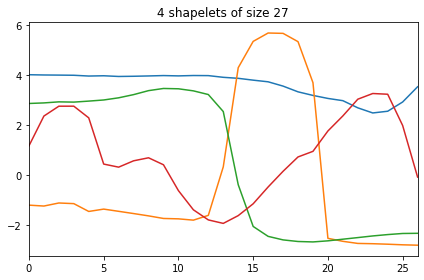

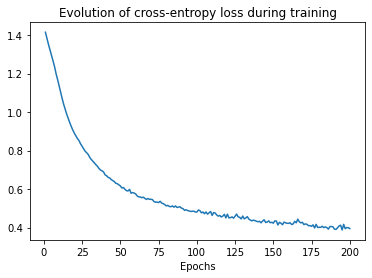

In [14]:
# Author: Romain Tavenard
# License: BSD 3 clause

import numpy
from sklearn.metrics import accuracy_score
import tensorflow as tf
import matplotlib.pyplot as plt

from tslearn.datasets import CachedDatasets
from tslearn.preprocessing import TimeSeriesScalerMinMax
from tslearn.shapelets import LearningShapelets, \
    grabocka_params_to_shapelet_size_dict
from tslearn.utils import ts_size

# Set seed for determinism
numpy.random.seed(0)

# Load the Trace dataset
X_train, y_train, X_test, y_test = CachedDatasets().load_dataset("Trace")

# Normalize each of the timeseries in the Trace dataset
X_train = TimeSeriesScalerMinMax().fit_transform(X_train)
X_test = TimeSeriesScalerMinMax().fit_transform(X_test)

# Get statistics of the dataset
n_ts, ts_sz = X_train.shape[:2]
n_classes = len(set(y_train))

# Set the number of shapelets per size as done in the original paper
shapelet_sizes = grabocka_params_to_shapelet_size_dict(n_ts=n_ts,
                                                       ts_sz=ts_sz,
                                                       n_classes=n_classes,
                                                       l=0.1,
                                                       r=1)

# Define the model using parameters provided by the authors (except that we
# use fewer iterations here)
shp_clf = LearningShapelets(n_shapelets_per_size=shapelet_sizes,
                            optimizer=tf.optimizers.Adam(.01),
                            batch_size=16,
                            weight_regularizer=.01,
                            max_iter=200,
                            random_state=42,
                            verbose=0)
shp_clf.fit(X_train, y_train)

# Make predictions and calculate accuracy score
pred_labels = shp_clf.predict(X_test)
print("Correct classification rate:", accuracy_score(y_test, pred_labels))

# Plot the different discovered shapelets
plt.figure()
for i, sz in enumerate(shapelet_sizes.keys()):
    plt.subplot(len(shapelet_sizes), 1, i + 1)
    plt.title("%d shapelets of size %d" % (shapelet_sizes[sz], sz))
    for shp in shp_clf.shapelets_:
        if ts_size(shp) == sz:
            plt.plot(shp.ravel())
    plt.xlim([0, max(shapelet_sizes.keys()) - 1])

plt.tight_layout()
plt.show()

# The loss history is accessible via the `model_` that is a keras model
plt.figure()
plt.plot(numpy.arange(1, shp_clf.n_iter_ + 1), shp_clf.history_["loss"])
plt.title("Evolution of cross-entropy loss during training")
plt.xlabel("Epochs")
plt.show()

___
# <a id =7> </a> **7. Backtest on unseen data**
___